In [1]:
# TODO: plot animation bins by z

In [2]:
#Step 1: Load the FITS file

from astropy.io import fits
from astropy.table import Table
import numpy as np
import pandas as pd 

# Open the FITS file and load the data
input_file = Table.read('combined_BPT_file.fits')
# hdul = fits.open(input_file)
# data = Table(hdul[1].data)

galaxy_data = input_file.to_pandas()
num_galaxies = len(galaxy_data)
print(f"Number of objects in the DataFrame: {num_galaxies}")


Number of objects in the DataFrame: 792392


In [3]:
#Step 2: Define bins for the abs_mag column

# Define the bin edges for `abs_mag` (you can adjust these ranges)
#bins = np.linspace(galaxy_data['abs_mag_r'].min(), galaxy_data['abs_mag_r'].max(), num=50)  # Create bins from MAX to MIN with 20 bins
bins = np.linspace(-22, -5, num=86)  # Create bins from -2 to -25with 125 bins
bins


array([-22. , -21.8, -21.6, -21.4, -21.2, -21. , -20.8, -20.6, -20.4,
       -20.2, -20. , -19.8, -19.6, -19.4, -19.2, -19. , -18.8, -18.6,
       -18.4, -18.2, -18. , -17.8, -17.6, -17.4, -17.2, -17. , -16.8,
       -16.6, -16.4, -16.2, -16. , -15.8, -15.6, -15.4, -15.2, -15. ,
       -14.8, -14.6, -14.4, -14.2, -14. , -13.8, -13.6, -13.4, -13.2,
       -13. , -12.8, -12.6, -12.4, -12.2, -12. , -11.8, -11.6, -11.4,
       -11.2, -11. , -10.8, -10.6, -10.4, -10.2, -10. ,  -9.8,  -9.6,
        -9.4,  -9.2,  -9. ,  -8.8,  -8.6,  -8.4,  -8.2,  -8. ,  -7.8,
        -7.6,  -7.4,  -7.2,  -7. ,  -6.8,  -6.6,  -6.4,  -6.2,  -6. ,
        -5.8,  -5.6,  -5.4,  -5.2,  -5. ])

In [4]:
# Ensure bins are in increasing order
bins = np.sort(bins)

# Check the types of the original magnitude data to ensure they're numeric
print(galaxy_data['abs_mag_r'].dtype)

# Optionally, using pandas.cut() for labeled bins
bin_labels = [f'{bins[i]:.2f} to {bins[i+1]:.2f}' for i in range(len(bins)-1)]
print(bin_labels)

# Apply the binning
binned_data = pd.cut(galaxy_data['abs_mag_r'], bins=bins, labels=bin_labels)

# Add the binned data as a new column
galaxy_data['abs_mag_bin'] = binned_data

# Now check the first few rows of the data to confirm the 'abs_mag_bin' column was added
print(galaxy_data.head())  # Preview the first few entries of the data


float64
['-22.00 to -21.80', '-21.80 to -21.60', '-21.60 to -21.40', '-21.40 to -21.20', '-21.20 to -21.00', '-21.00 to -20.80', '-20.80 to -20.60', '-20.60 to -20.40', '-20.40 to -20.20', '-20.20 to -20.00', '-20.00 to -19.80', '-19.80 to -19.60', '-19.60 to -19.40', '-19.40 to -19.20', '-19.20 to -19.00', '-19.00 to -18.80', '-18.80 to -18.60', '-18.60 to -18.40', '-18.40 to -18.20', '-18.20 to -18.00', '-18.00 to -17.80', '-17.80 to -17.60', '-17.60 to -17.40', '-17.40 to -17.20', '-17.20 to -17.00', '-17.00 to -16.80', '-16.80 to -16.60', '-16.60 to -16.40', '-16.40 to -16.20', '-16.20 to -16.00', '-16.00 to -15.80', '-15.80 to -15.60', '-15.60 to -15.40', '-15.40 to -15.20', '-15.20 to -15.00', '-15.00 to -14.80', '-14.80 to -14.60', '-14.60 to -14.40', '-14.40 to -14.20', '-14.20 to -14.00', '-14.00 to -13.80', '-13.80 to -13.60', '-13.60 to -13.40', '-13.40 to -13.20', '-13.20 to -13.00', '-13.00 to -12.80', '-12.80 to -12.60', '-12.60 to -12.40', '-12.40 to -12.20', '-12.20 to 

In [5]:
# Step 4: Handle any NaN or non-string values in the 'abs_mag_bin' column

# Check for any non-string values in 'abs_mag_bin'
non_strings = []
for value in galaxy_data['abs_mag_bin']:
    if not isinstance(value, str):
        non_strings.append(value)

print(f"Non-string values in 'abs_mag_bin': {non_strings}")

# Step 6: Group the data by the binned values and perform any aggregation
grouped = galaxy_data.groupby('abs_mag_bin', observed=False).size()

# Example: Count how many objects fall into each bin
print(grouped)


Non-string values in 'abs_mag_bin': [nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan]
abs_mag_bin
-22.00 to -21.80    2
-21.80 to -21.60    3
-21.60 to -21.40    3
-21.40 to -21.20    3
-21.20 to -21.00    3
                   ..
-6.00 to -5.80      6
-5.80 to -5.60      5
-5.60 to -5.40      3
-5.40 to -5.20      2
-5.20 to -5.00      4
Length: 85, dtype: int64


In [6]:
# bin redshift values like we did with abs_mag before

#redshift_bin = np.linspace(galaxy_data['abs_mag_r'].min(), galaxy_data['abs_mag_r'].max(), num=50)  # Create bins from MAX to MIN with 20 bins
redshift_bin = np.linspace(0.001, 0.7, num=16)  # Create bins from MAX to MIN with 20 bins
galaxy_data['z_bin'] = pd.cut(galaxy_data['z'], bins=redshift_bin) # assigns each galaxy a z_bin range

redshift_bin

array([0.001 , 0.0476, 0.0942, 0.1408, 0.1874, 0.234 , 0.2806, 0.3272,
       0.3738, 0.4204, 0.467 , 0.5136, 0.5602, 0.6068, 0.6534, 0.7   ])

# Take only flux > 0, SNR=flux/flux_err > 3, (NII/Hbeta & OIII/Halpha) > 0

Valid data points: 1 for bin -22.00 to -21.80
No valid points for bin -22.00 to -21.80. Skipping plot.
Valid data points: 1 for bin -21.80 to -21.60


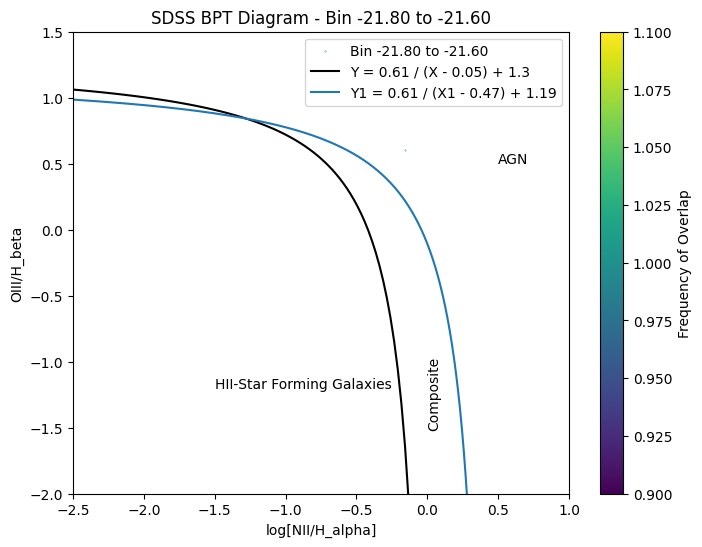

Valid data points: 2 for bin -21.60 to -21.40


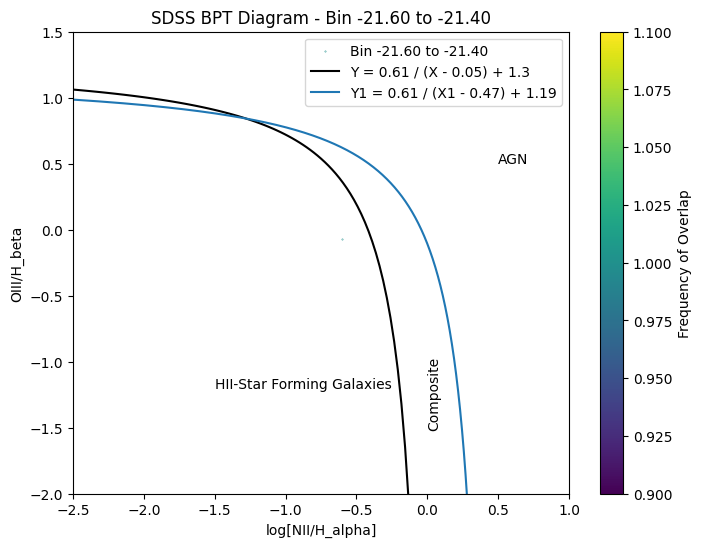

Valid data points: 1 for bin -21.40 to -21.20


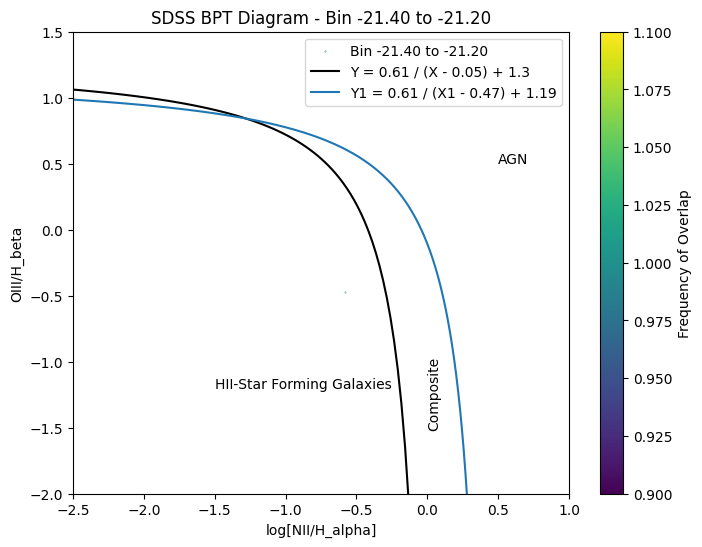

Valid data points: 2 for bin -21.20 to -21.00


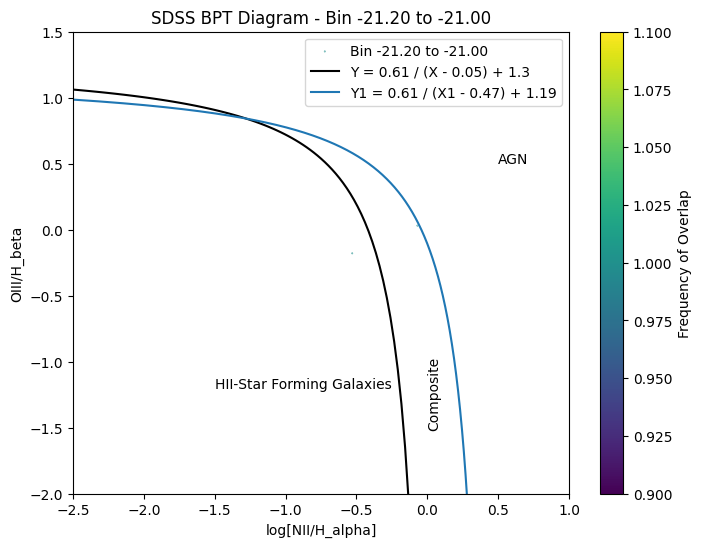

Valid data points: 4 for bin -21.00 to -20.80


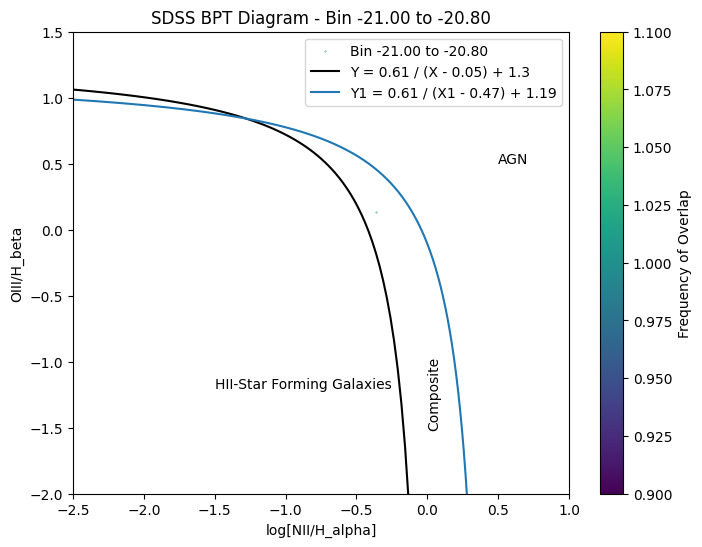

Valid data points: 2 for bin -20.80 to -20.60


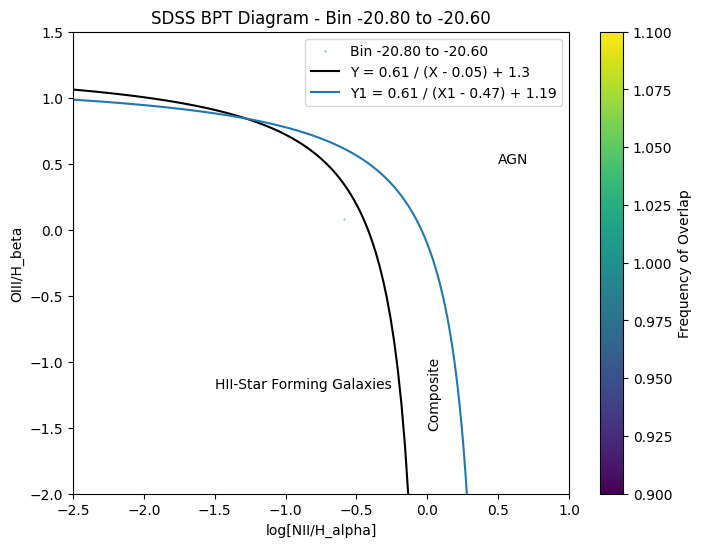

Valid data points: 4 for bin -20.60 to -20.40


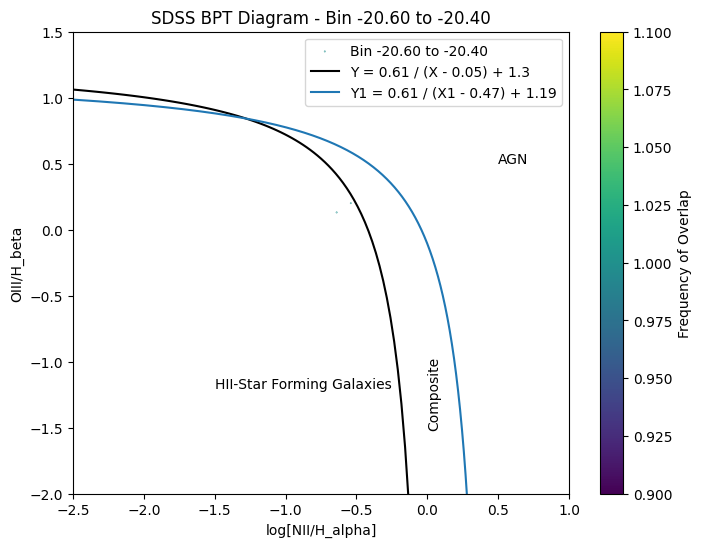

Valid data points: 4 for bin -20.40 to -20.20


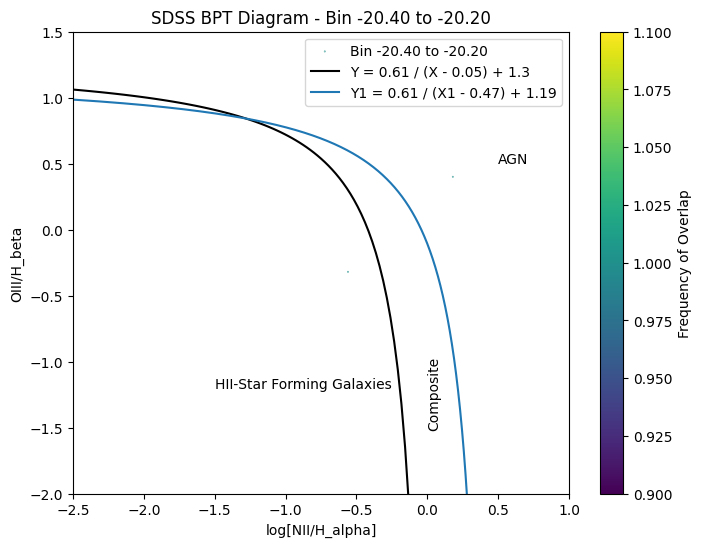

Valid data points: 3 for bin -20.20 to -20.00


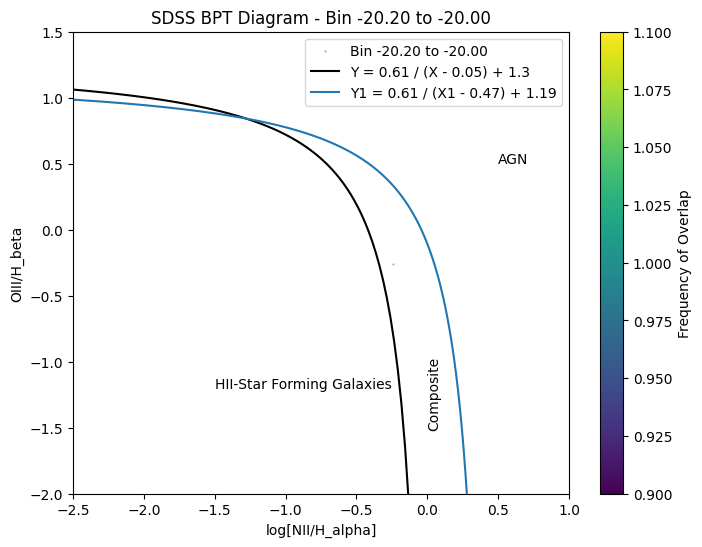

Valid data points: 1 for bin -20.00 to -19.80


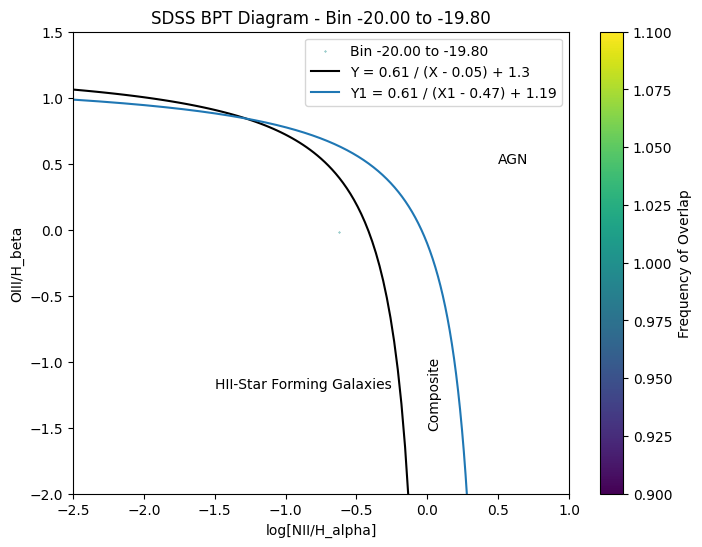

Valid data points: 4 for bin -19.80 to -19.60


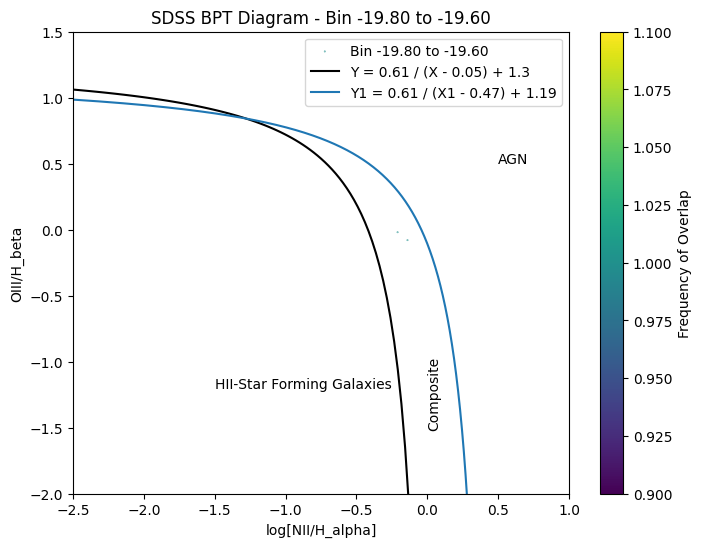

Valid data points: 3 for bin -19.60 to -19.40


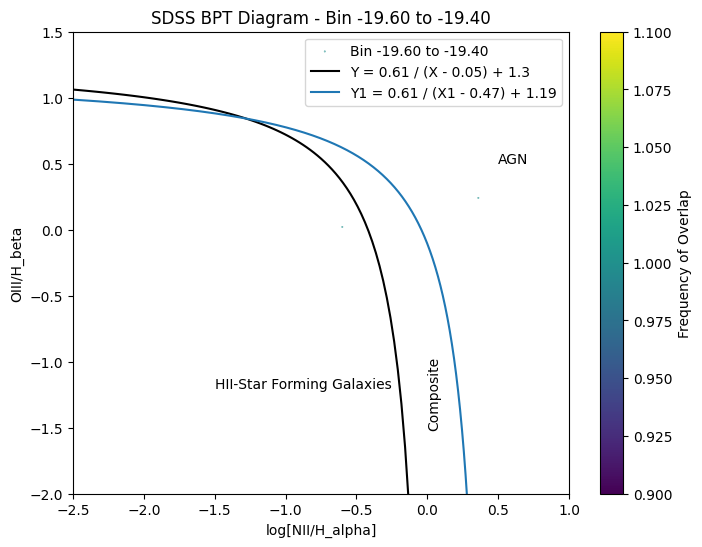

Valid data points: 6 for bin -19.40 to -19.20


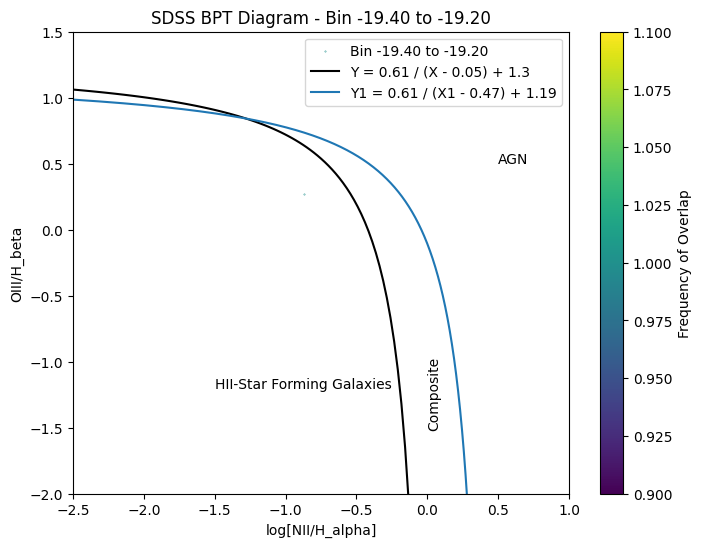

Valid data points: 11 for bin -19.20 to -19.00


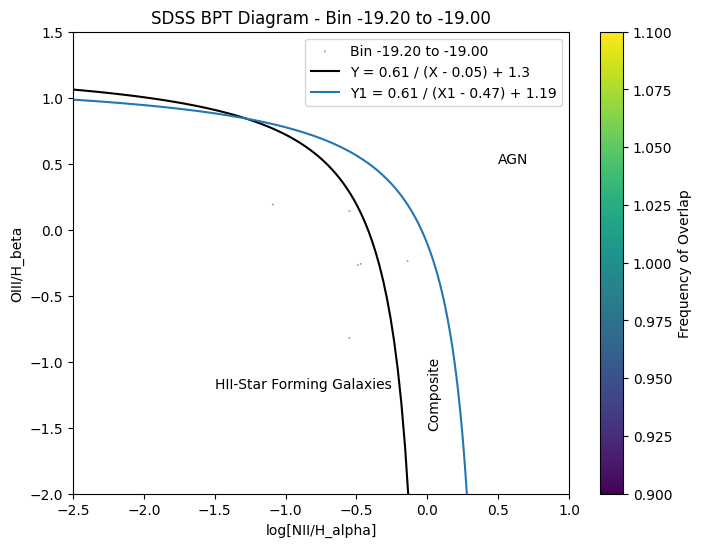

Valid data points: 17 for bin -19.00 to -18.80


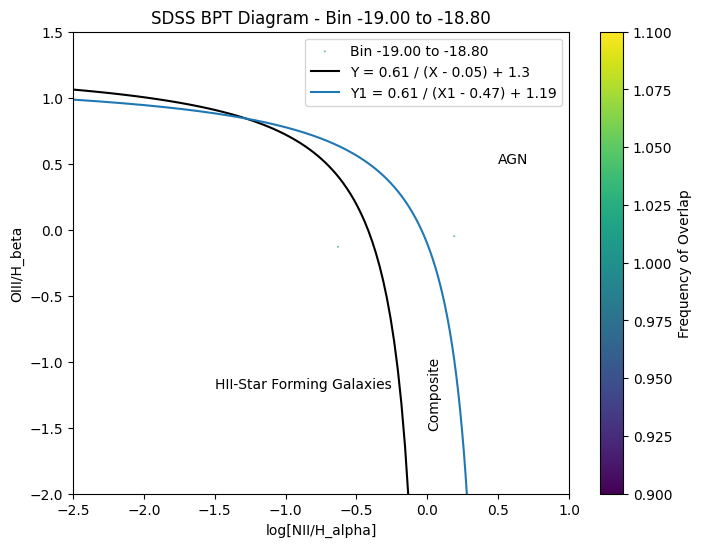

Valid data points: 74 for bin -18.80 to -18.60


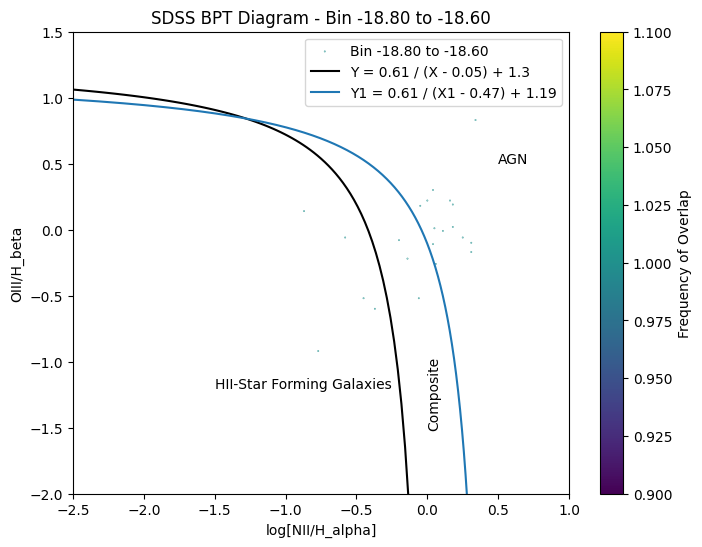

Valid data points: 197 for bin -18.60 to -18.40


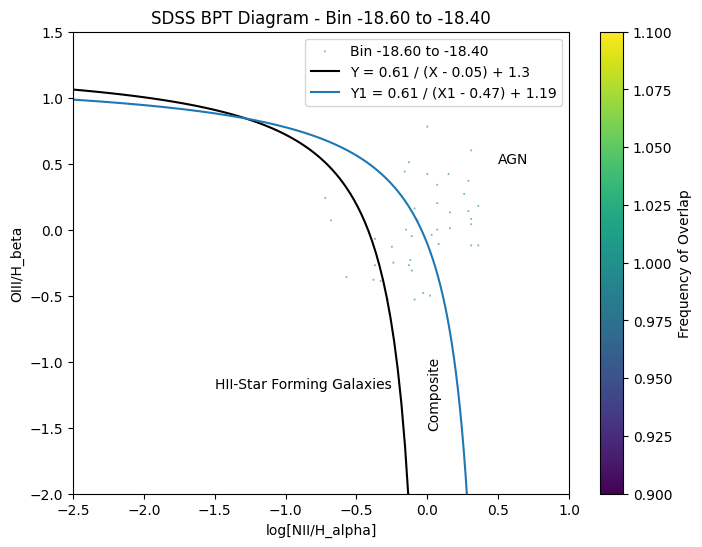

Valid data points: 547 for bin -18.40 to -18.20


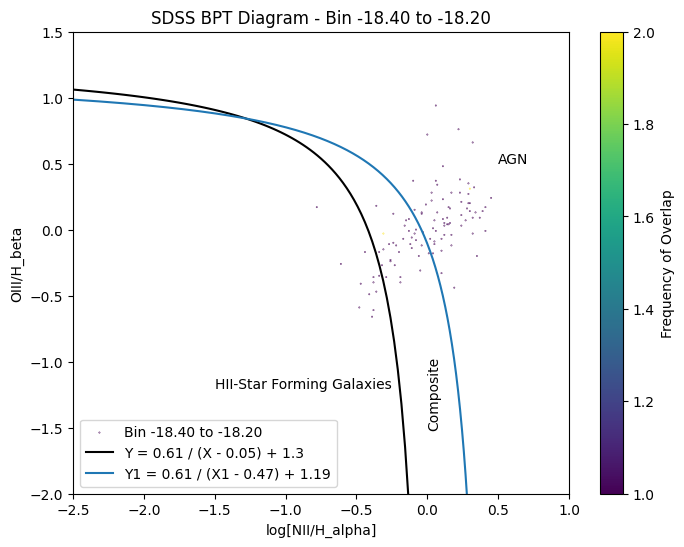

Valid data points: 1374 for bin -18.20 to -18.00


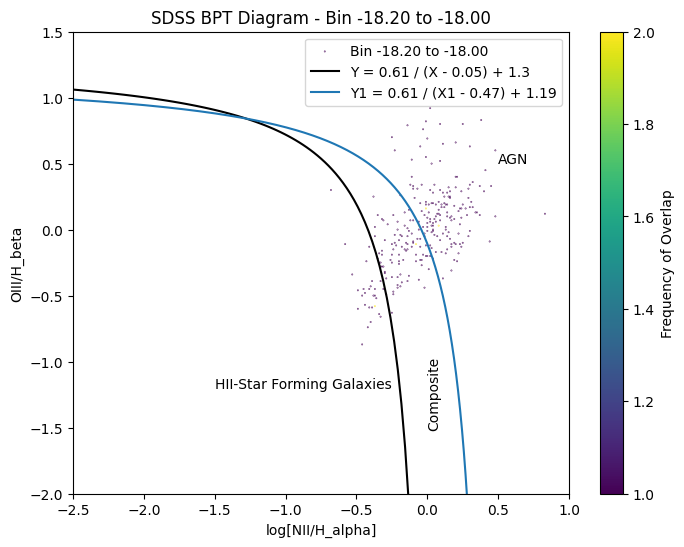

Valid data points: 3573 for bin -18.00 to -17.80


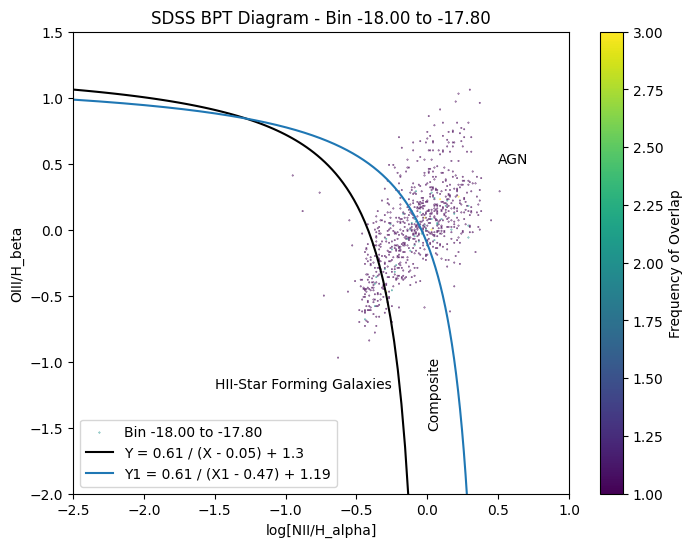

Valid data points: 8050 for bin -17.80 to -17.60


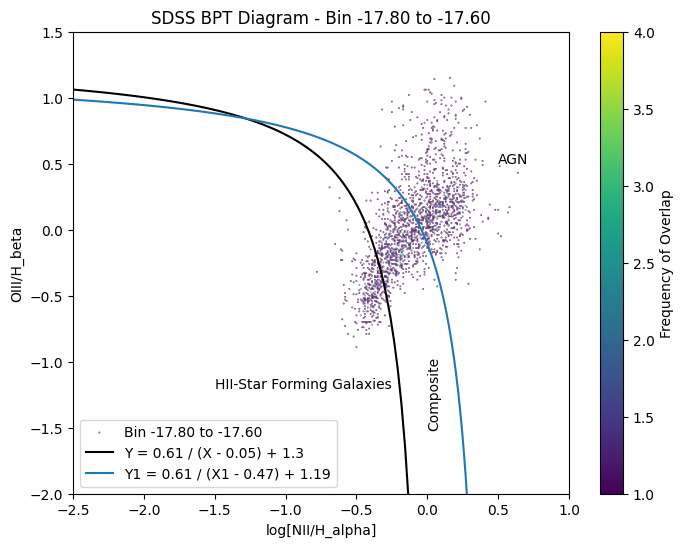

Valid data points: 15418 for bin -17.60 to -17.40


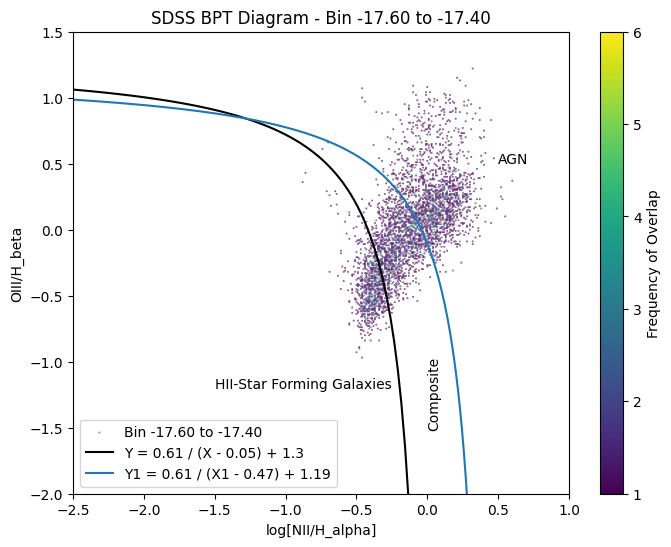

Valid data points: 25573 for bin -17.40 to -17.20


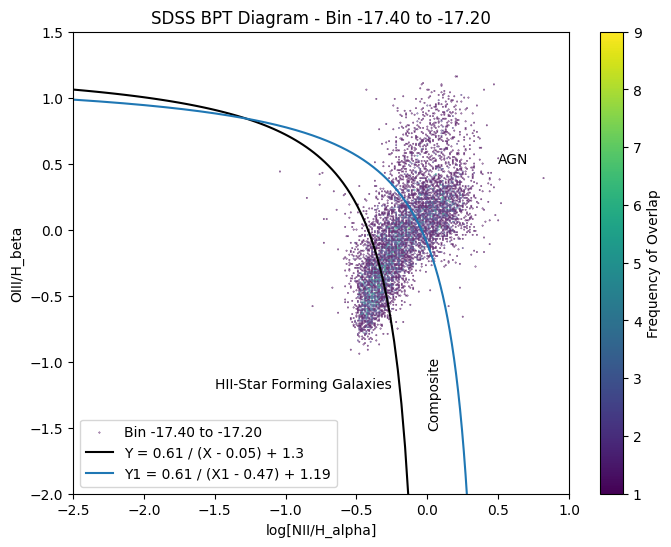

Valid data points: 33914 for bin -17.20 to -17.00


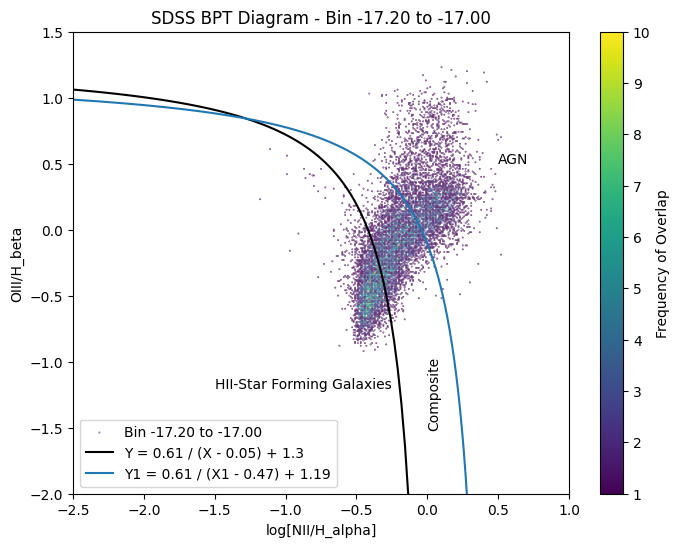

Valid data points: 40664 for bin -17.00 to -16.80


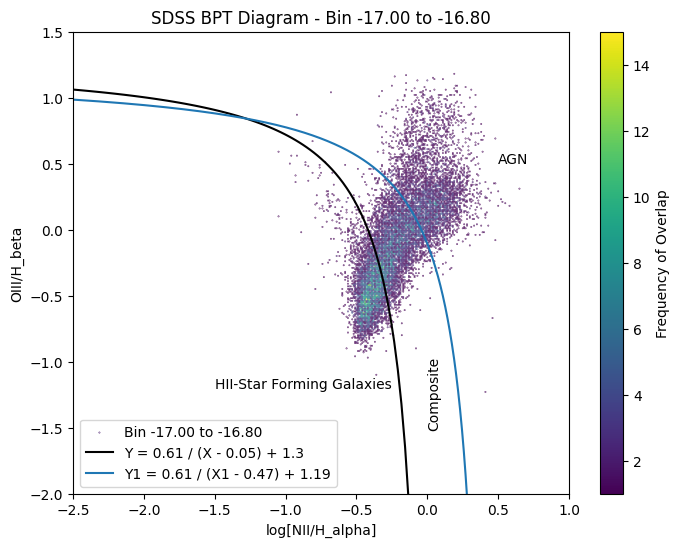

Valid data points: 46491 for bin -16.80 to -16.60


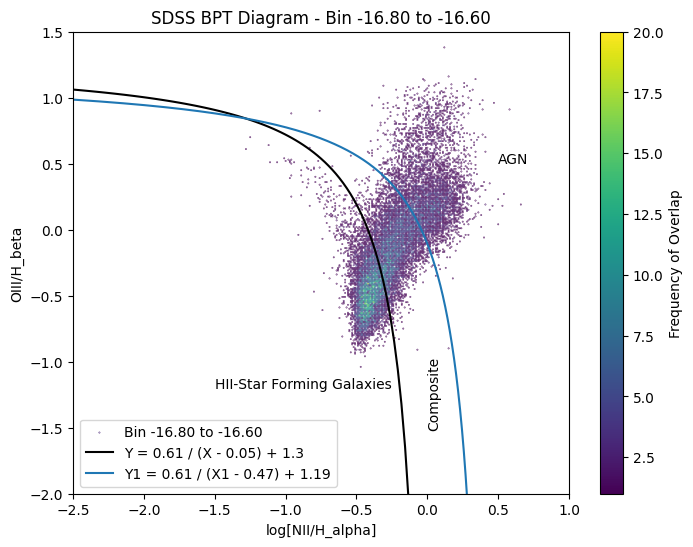

Valid data points: 50195 for bin -16.60 to -16.40


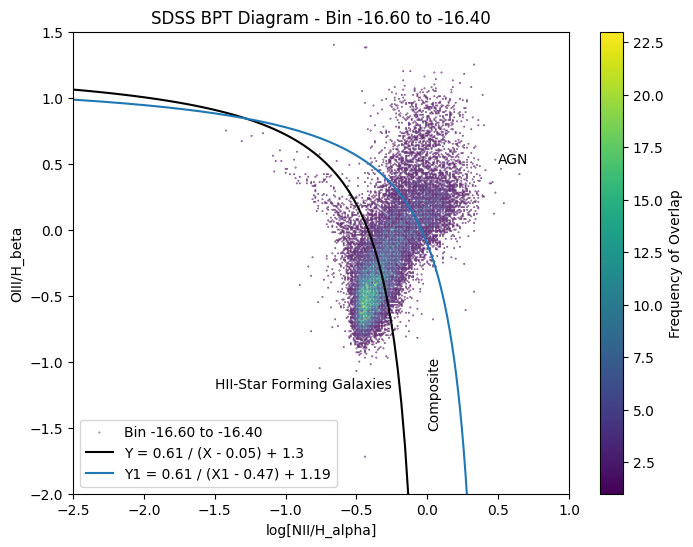

Valid data points: 50849 for bin -16.40 to -16.20


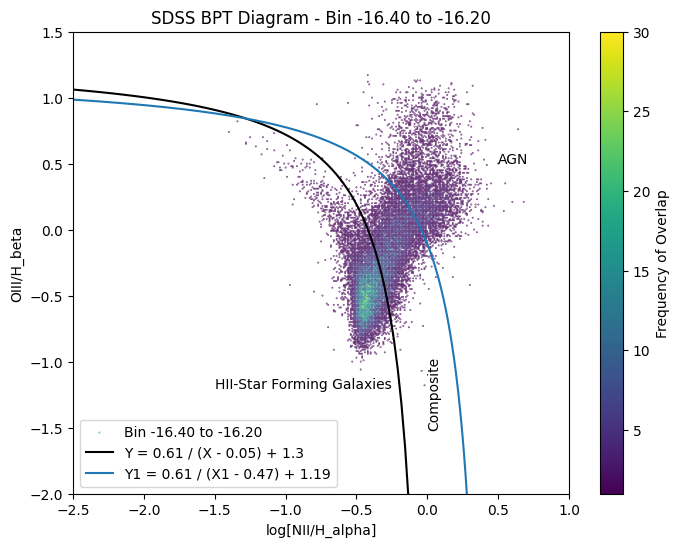

Valid data points: 49743 for bin -16.20 to -16.00


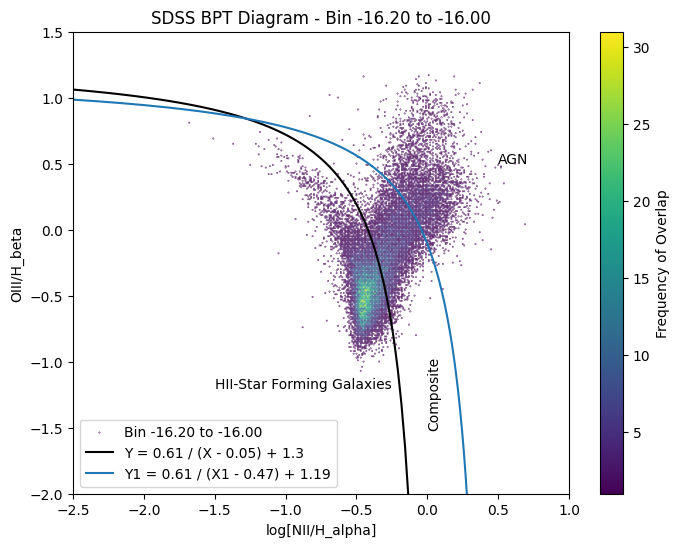

Valid data points: 45661 for bin -16.00 to -15.80


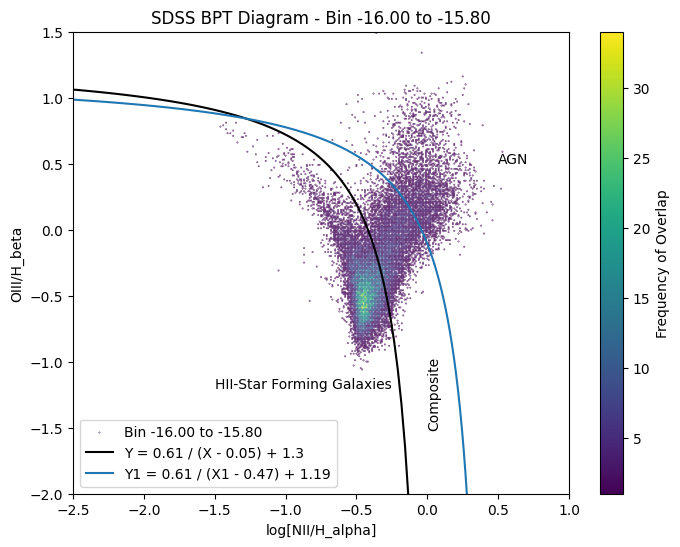

Valid data points: 41514 for bin -15.80 to -15.60


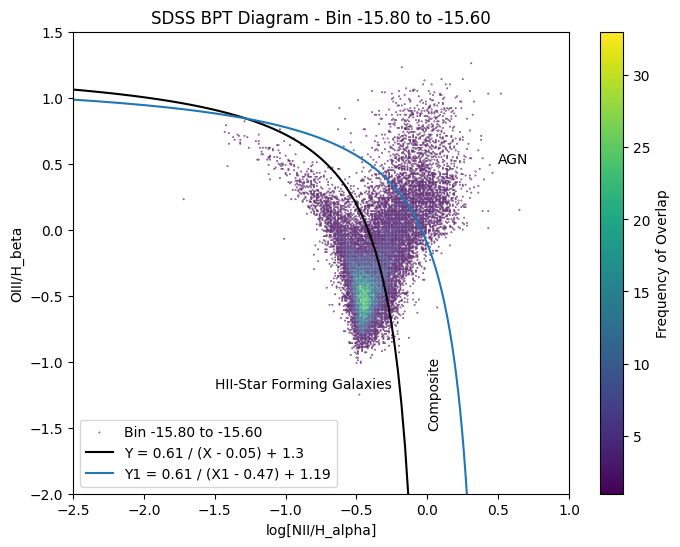

Valid data points: 36635 for bin -15.60 to -15.40


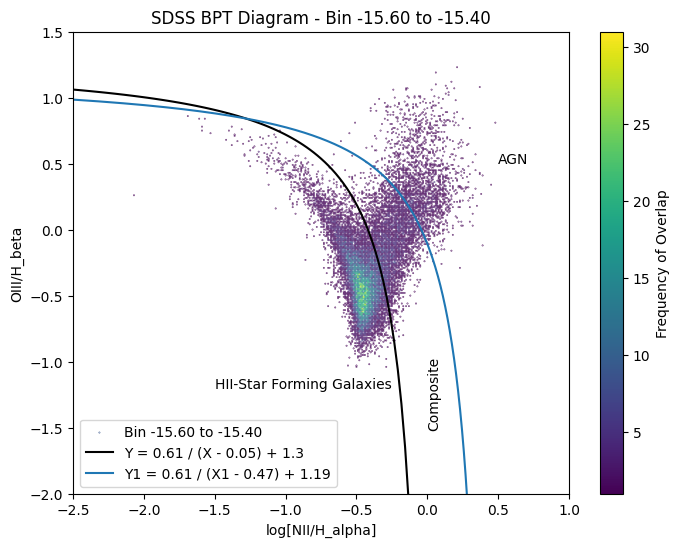

Valid data points: 31959 for bin -15.40 to -15.20


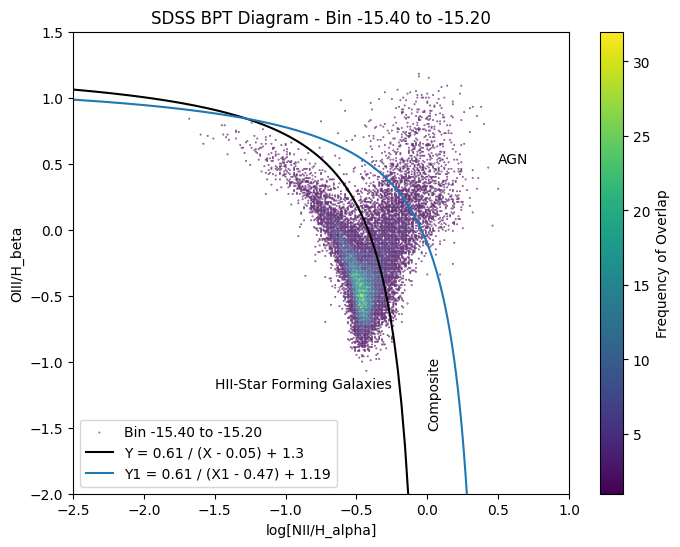

Valid data points: 27361 for bin -15.20 to -15.00


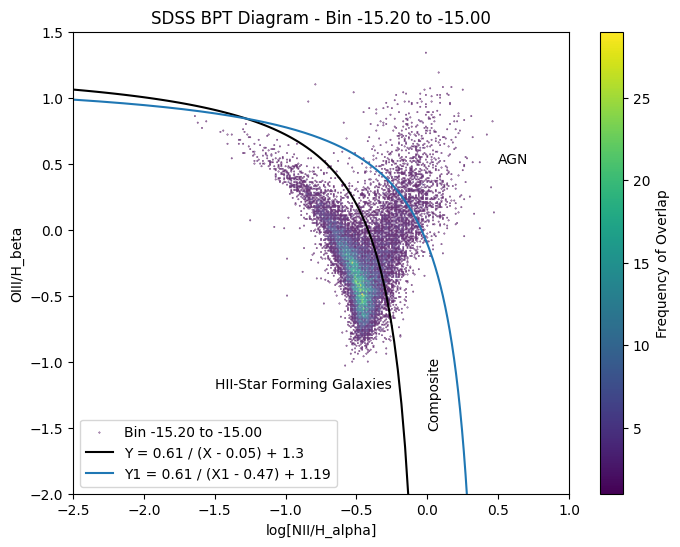

Valid data points: 22835 for bin -15.00 to -14.80


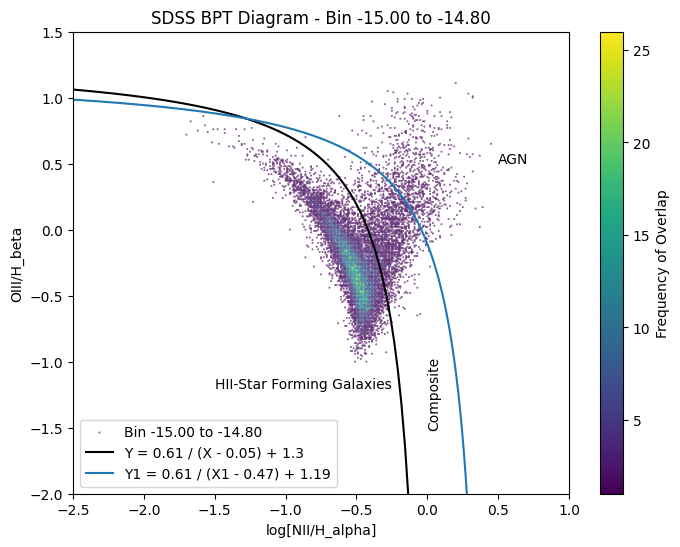

Valid data points: 17695 for bin -14.80 to -14.60


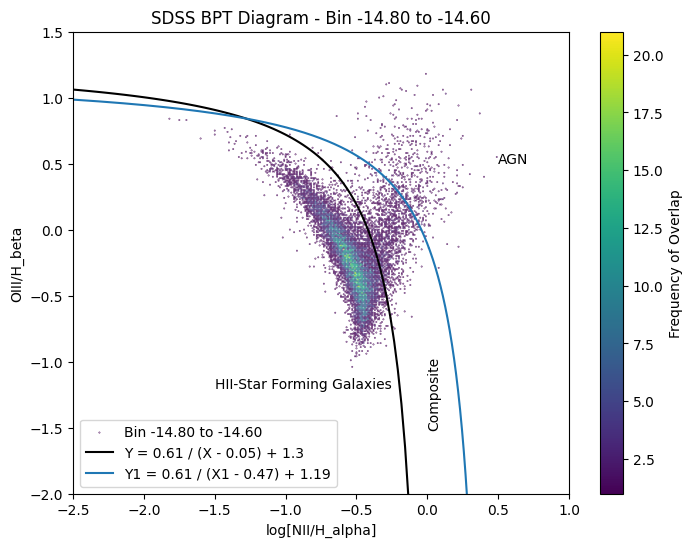

Valid data points: 14260 for bin -14.60 to -14.40


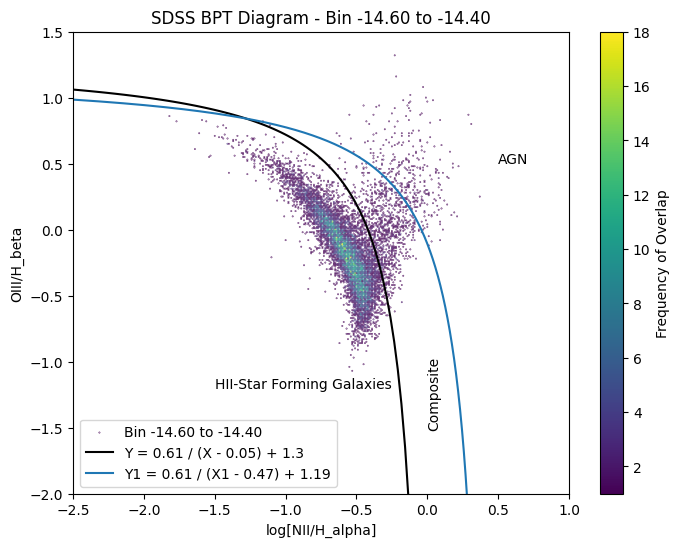

Valid data points: 11176 for bin -14.40 to -14.20


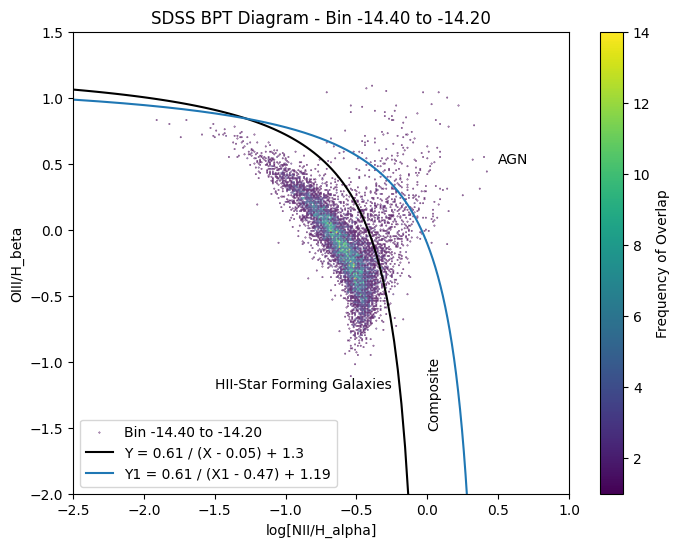

Valid data points: 9439 for bin -14.20 to -14.00


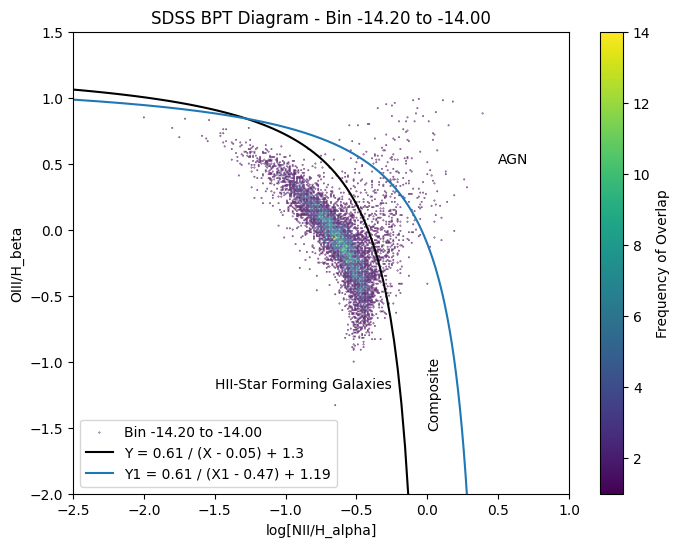

Valid data points: 7804 for bin -14.00 to -13.80


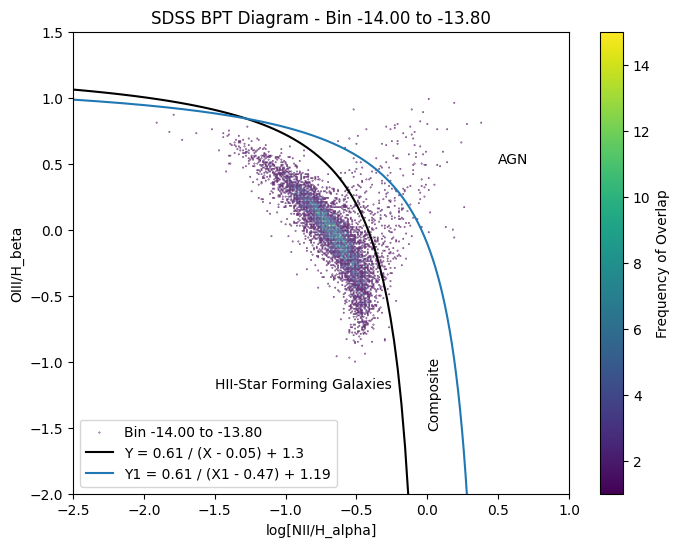

Valid data points: 6411 for bin -13.80 to -13.60


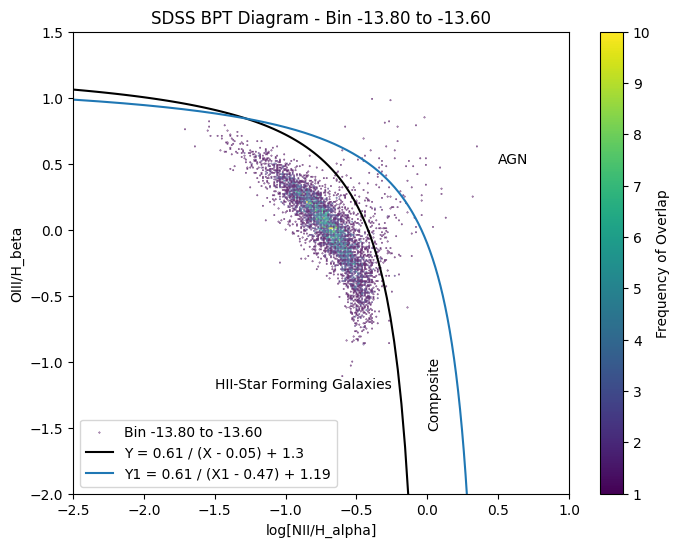

Valid data points: 5326 for bin -13.60 to -13.40


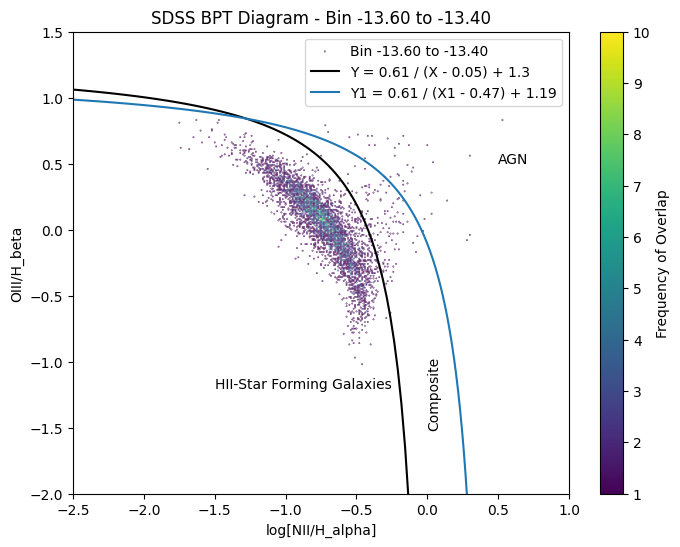

Valid data points: 4509 for bin -13.40 to -13.20


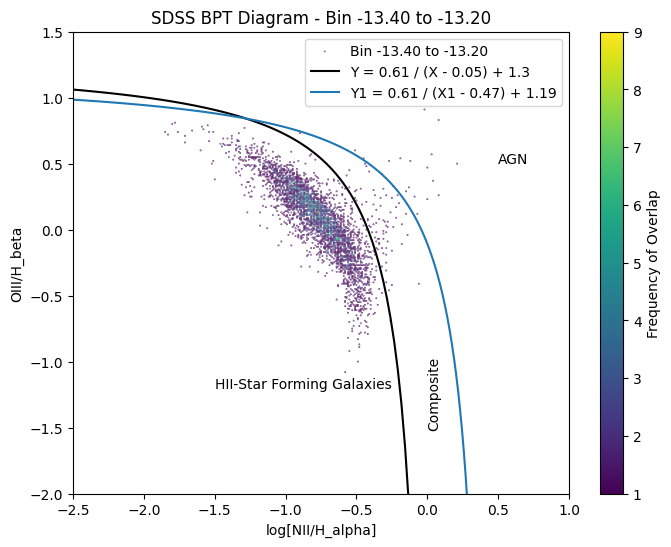

Valid data points: 3733 for bin -13.20 to -13.00


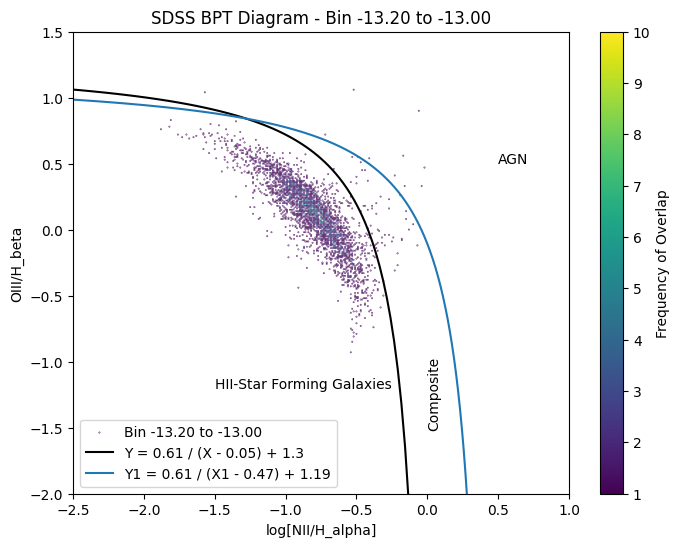

Valid data points: 3147 for bin -13.00 to -12.80


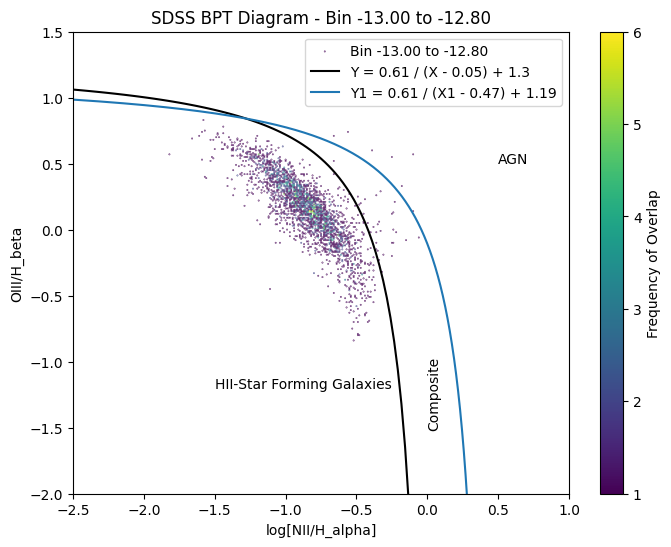

Valid data points: 2522 for bin -12.80 to -12.60


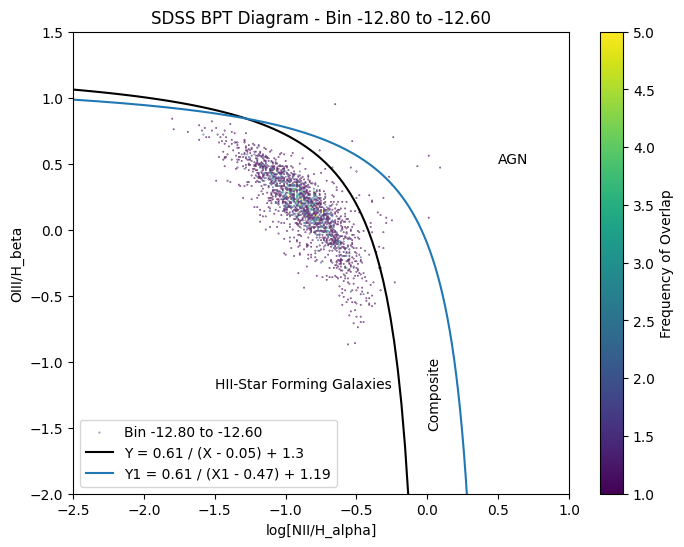

Valid data points: 1921 for bin -12.60 to -12.40


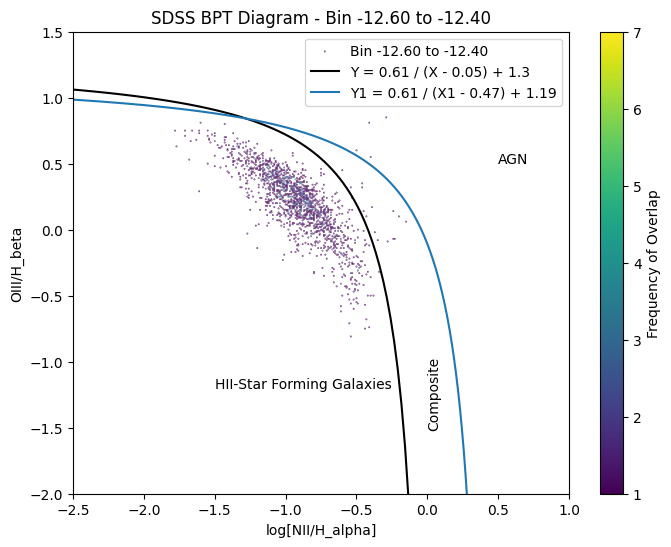

Valid data points: 1507 for bin -12.40 to -12.20


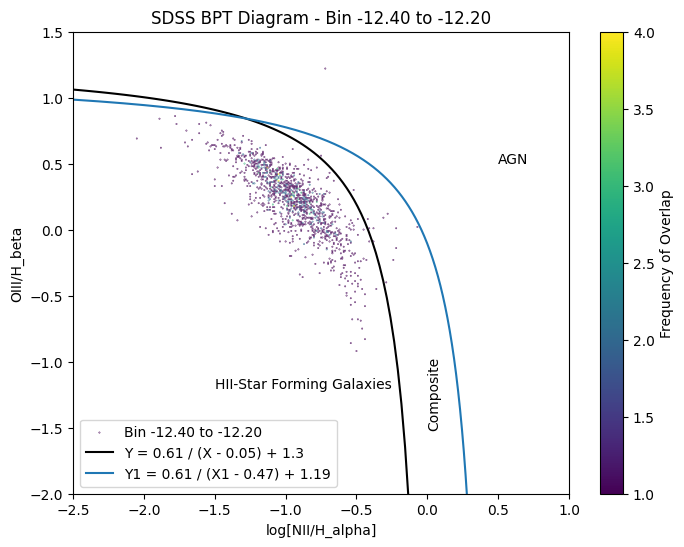

Valid data points: 1158 for bin -12.20 to -12.00


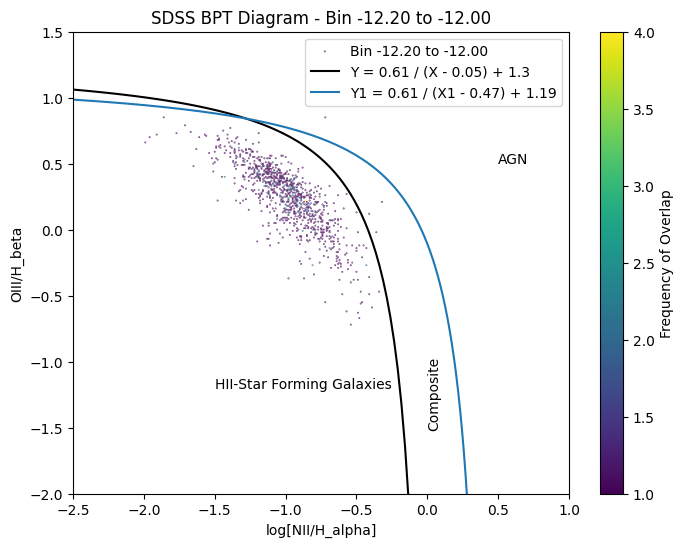

Valid data points: 802 for bin -12.00 to -11.80


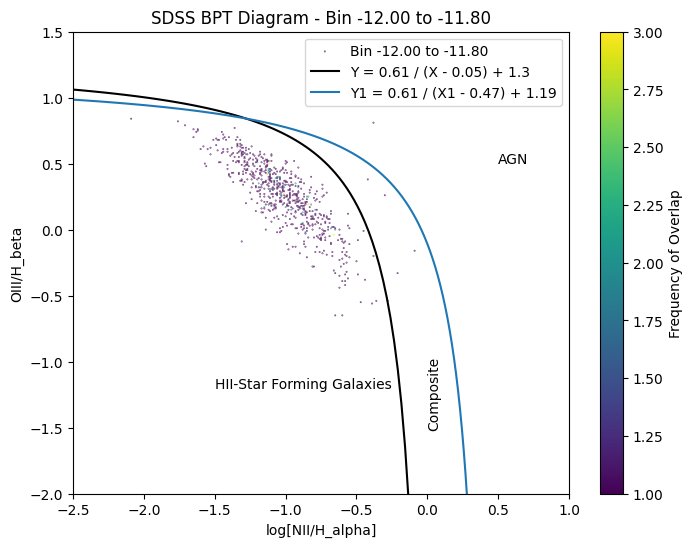

Valid data points: 733 for bin -11.80 to -11.60


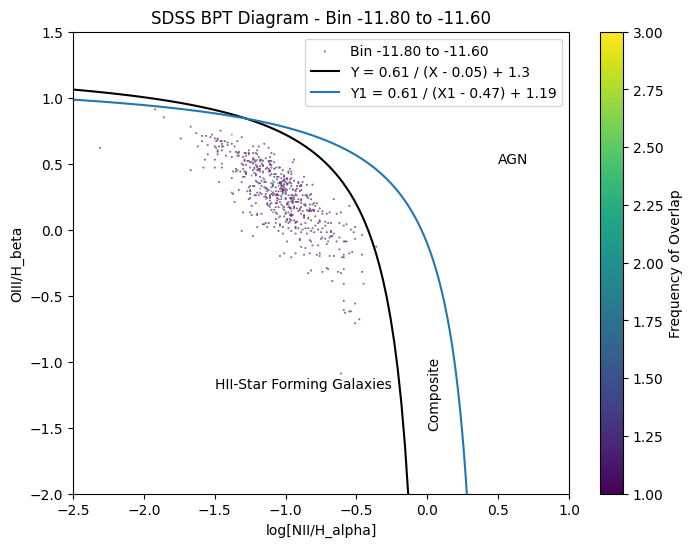

Valid data points: 563 for bin -11.60 to -11.40


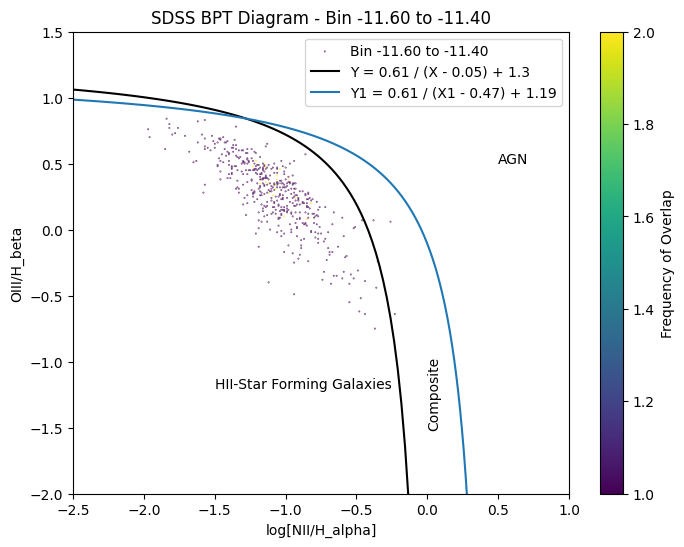

Valid data points: 495 for bin -11.40 to -11.20


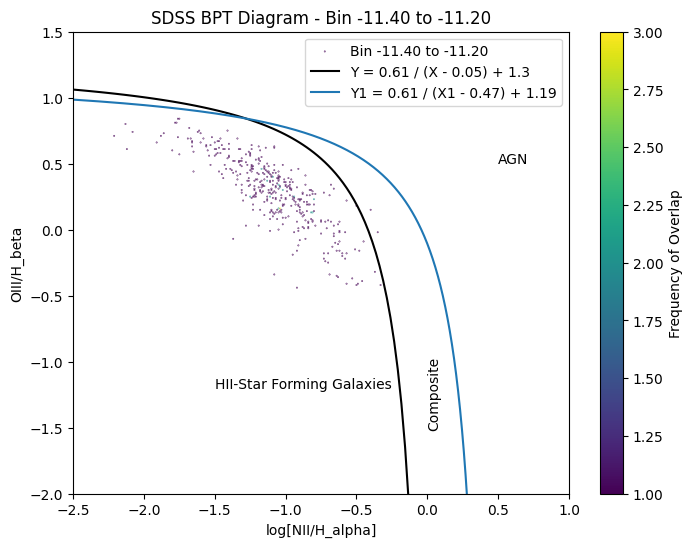

Valid data points: 405 for bin -11.20 to -11.00


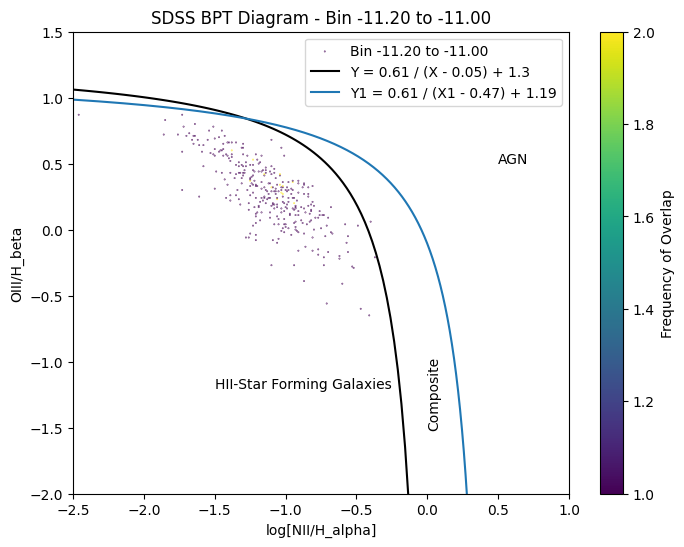

Valid data points: 335 for bin -11.00 to -10.80


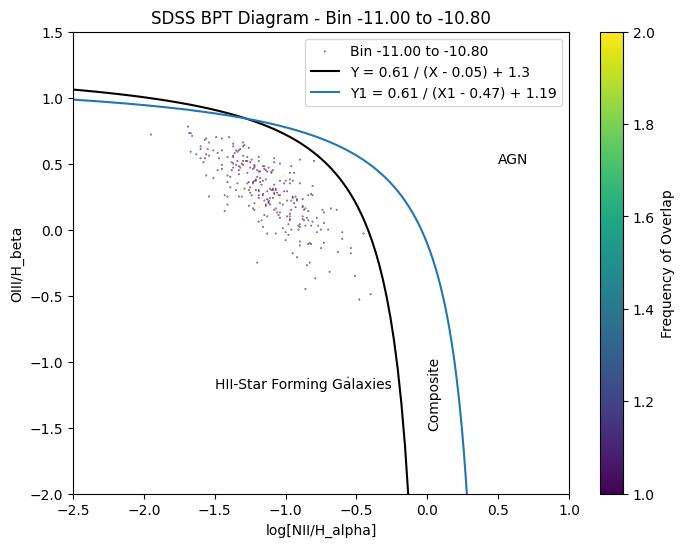

Valid data points: 303 for bin -10.80 to -10.60


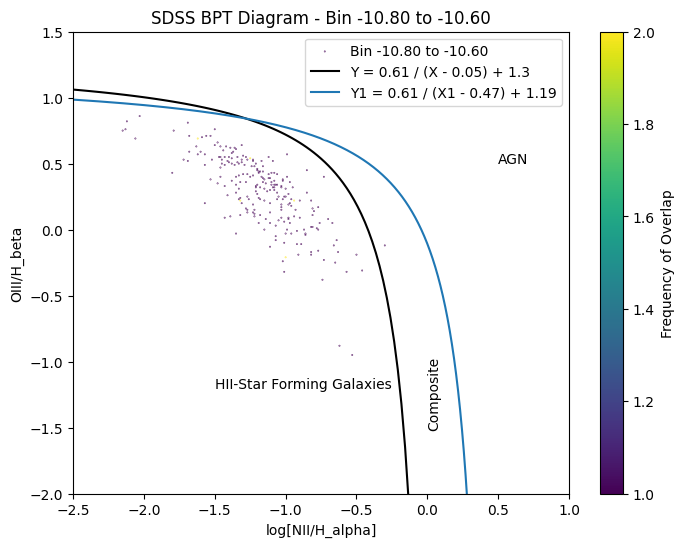

Valid data points: 221 for bin -10.60 to -10.40


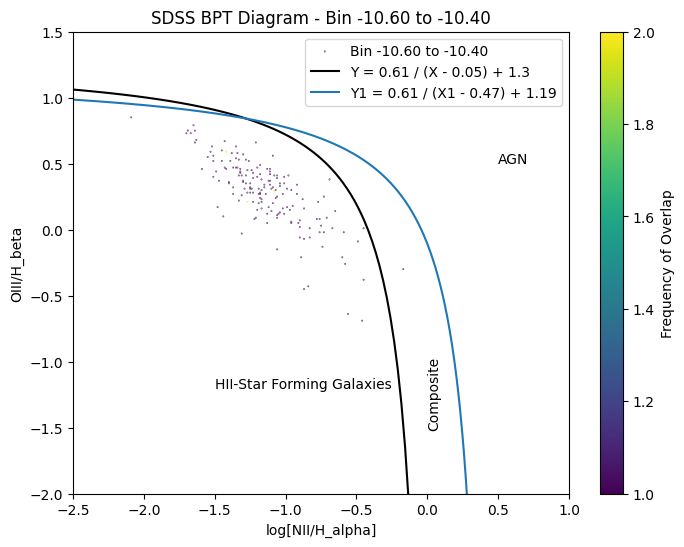

Valid data points: 227 for bin -10.40 to -10.20


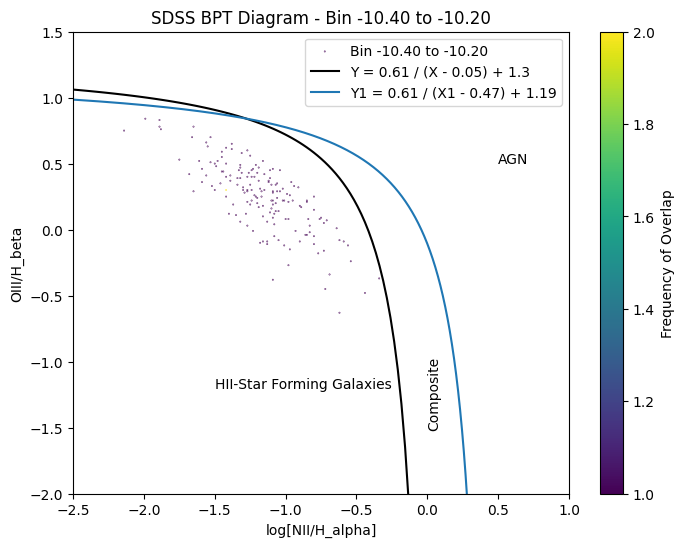

Valid data points: 186 for bin -10.20 to -10.00


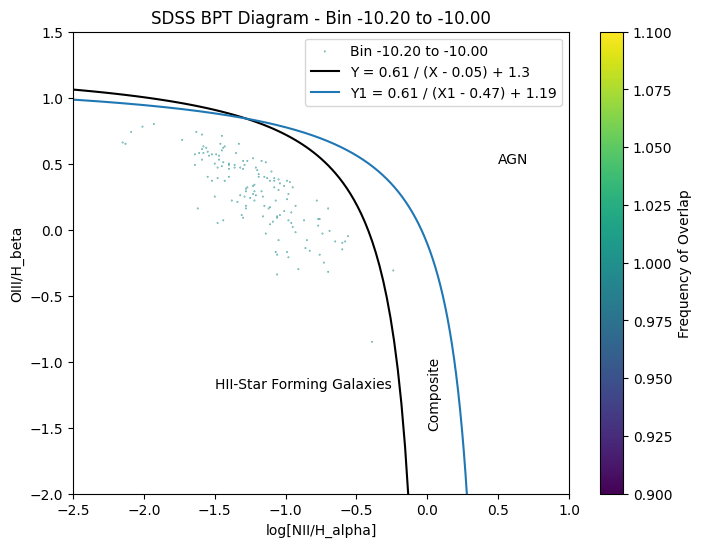

Valid data points: 159 for bin -10.00 to -9.80


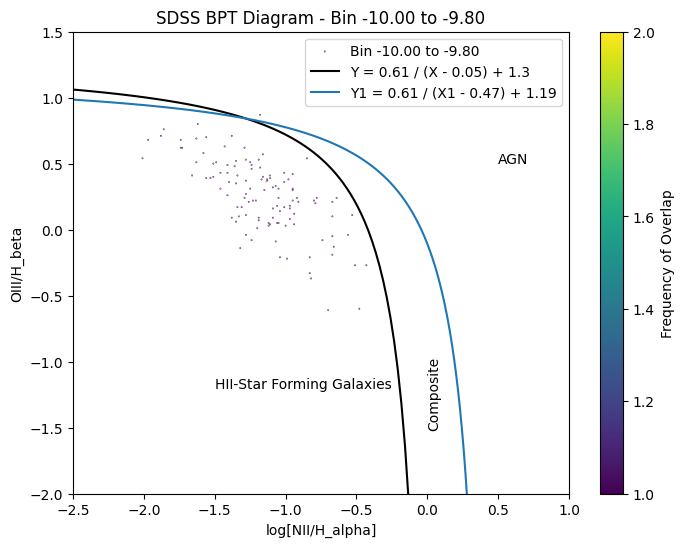

Valid data points: 155 for bin -9.80 to -9.60


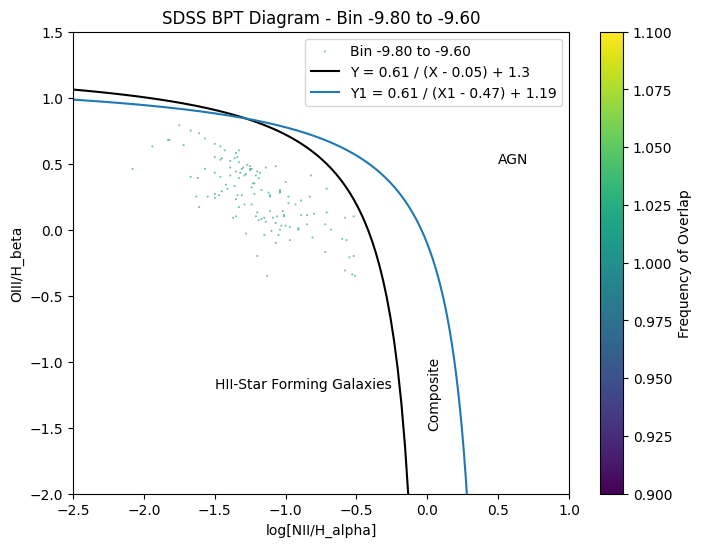

Valid data points: 120 for bin -9.60 to -9.40


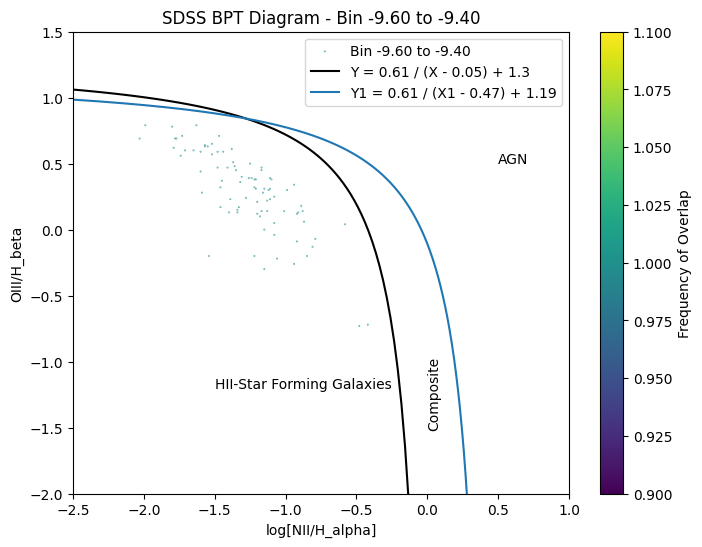

Valid data points: 103 for bin -9.40 to -9.20


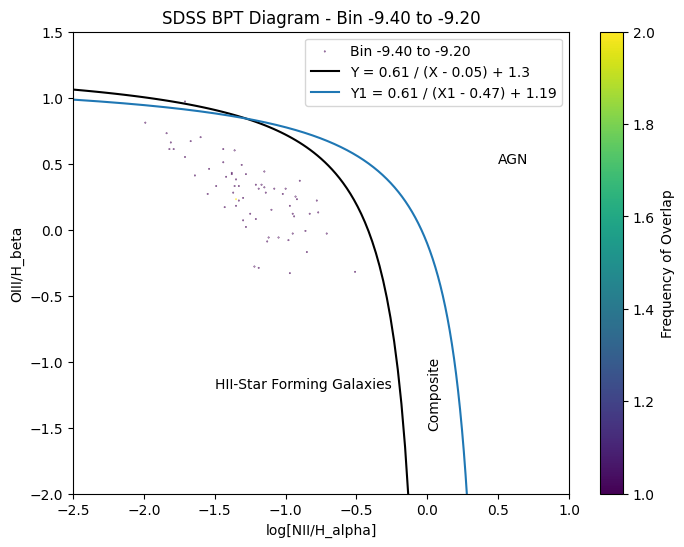

Valid data points: 80 for bin -9.20 to -9.00


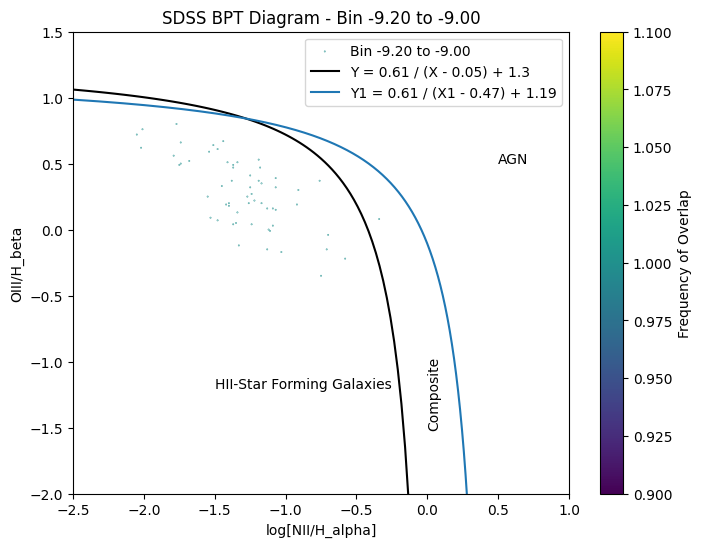

Valid data points: 74 for bin -9.00 to -8.80


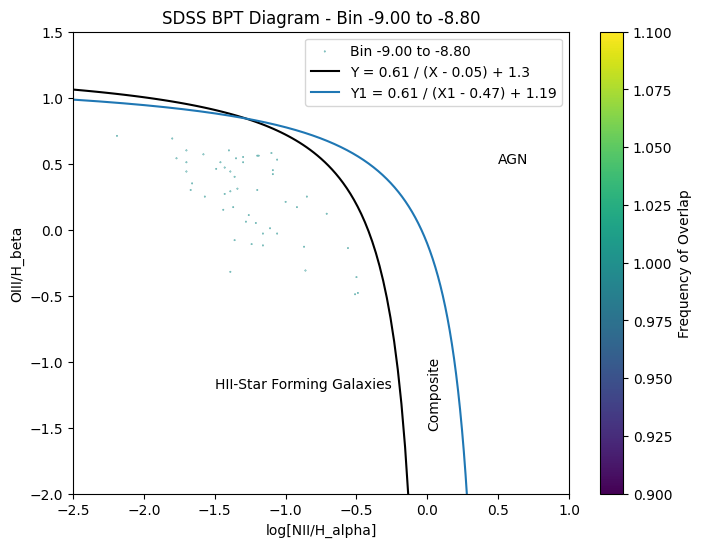

Valid data points: 67 for bin -8.80 to -8.60


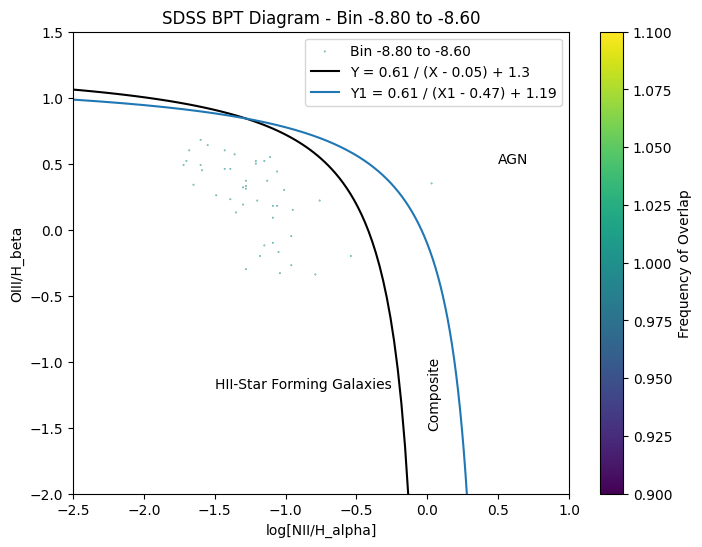

Valid data points: 49 for bin -8.60 to -8.40


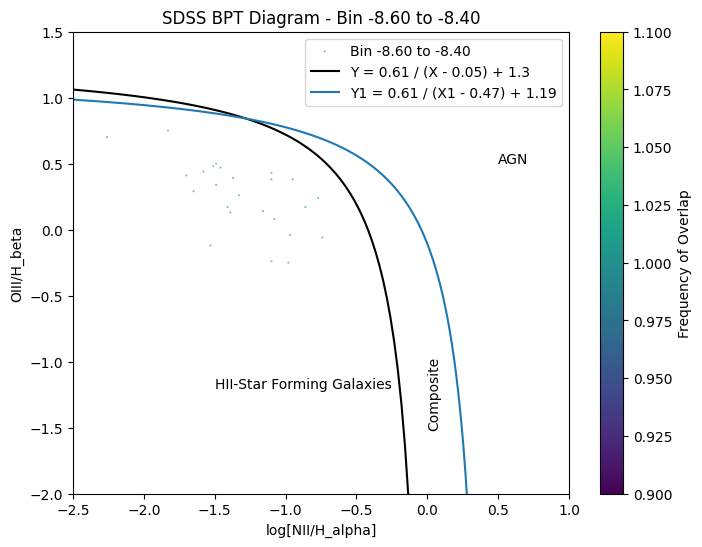

Valid data points: 47 for bin -8.40 to -8.20


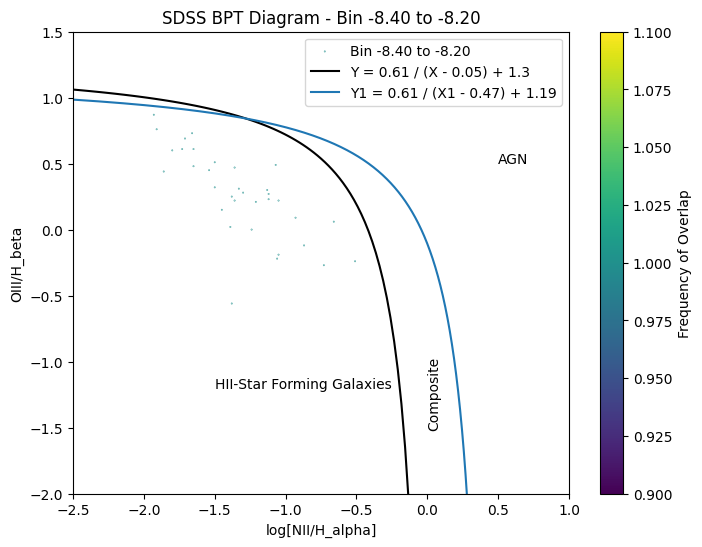

Valid data points: 30 for bin -8.20 to -8.00


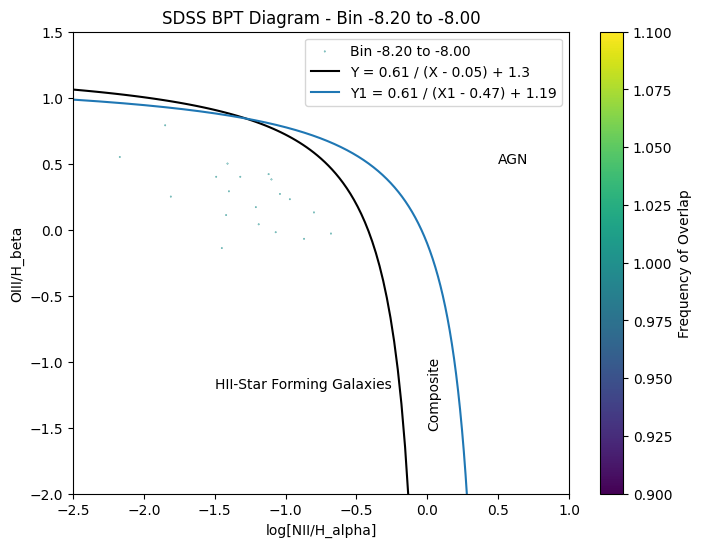

Valid data points: 23 for bin -8.00 to -7.80


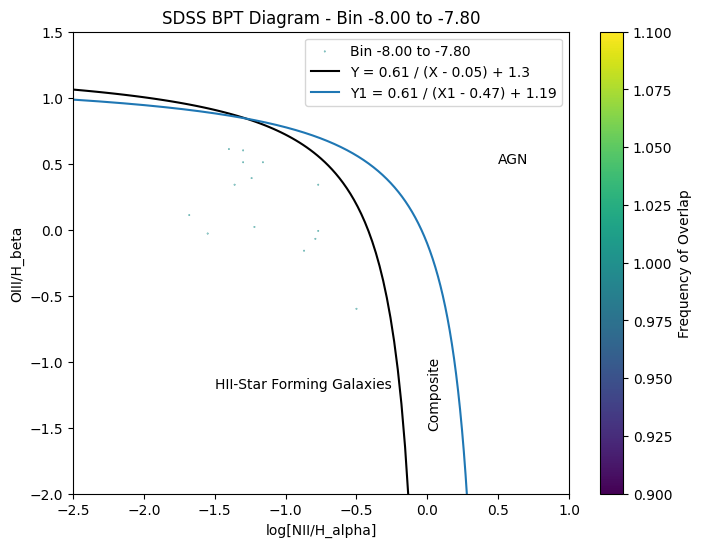

Valid data points: 19 for bin -7.80 to -7.60


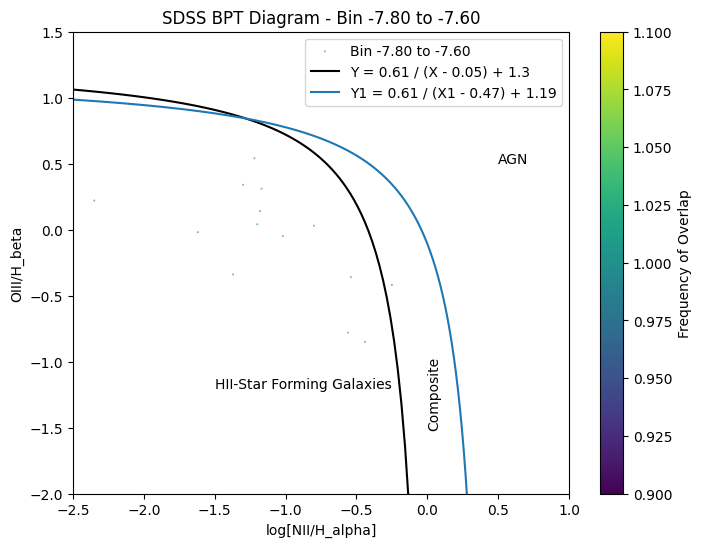

Valid data points: 18 for bin -7.60 to -7.40


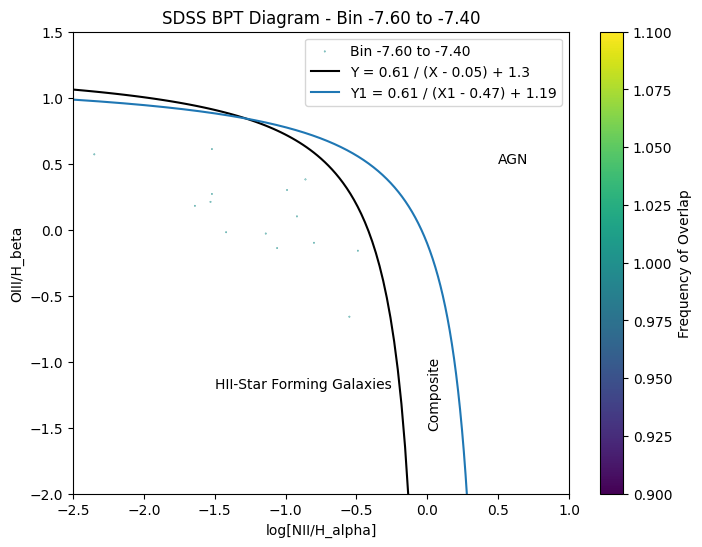

Valid data points: 9 for bin -7.40 to -7.20


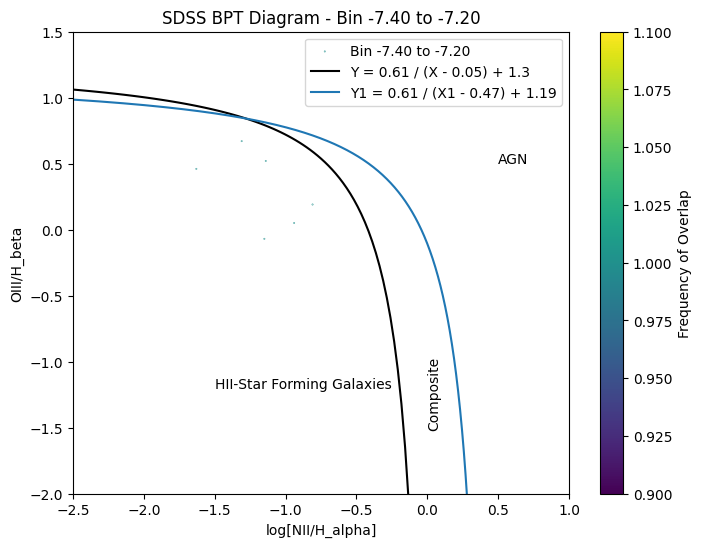

Valid data points: 11 for bin -7.20 to -7.00


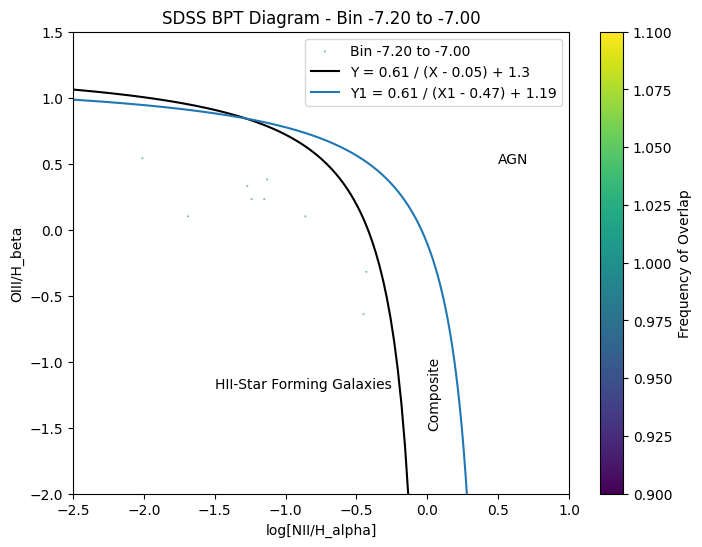

Valid data points: 10 for bin -7.00 to -6.80


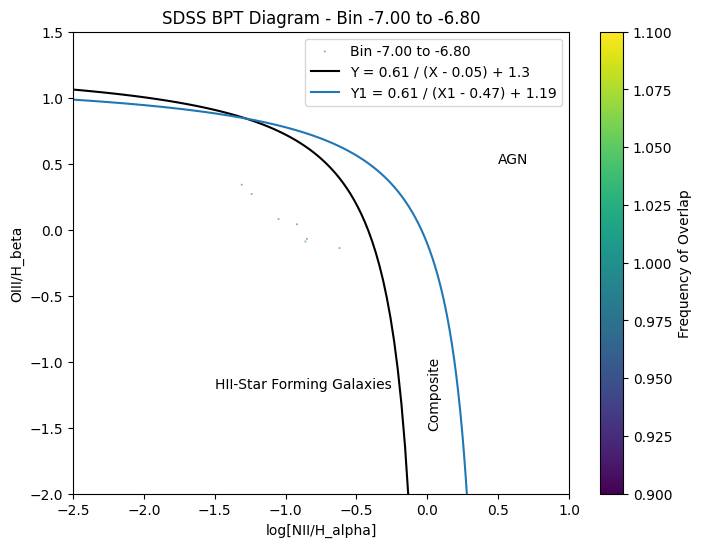

Valid data points: 14 for bin -6.80 to -6.60


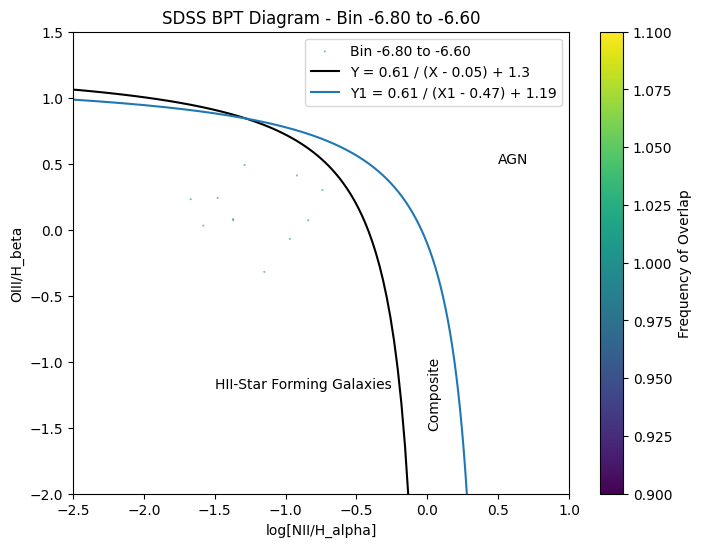

Valid data points: 7 for bin -6.60 to -6.40


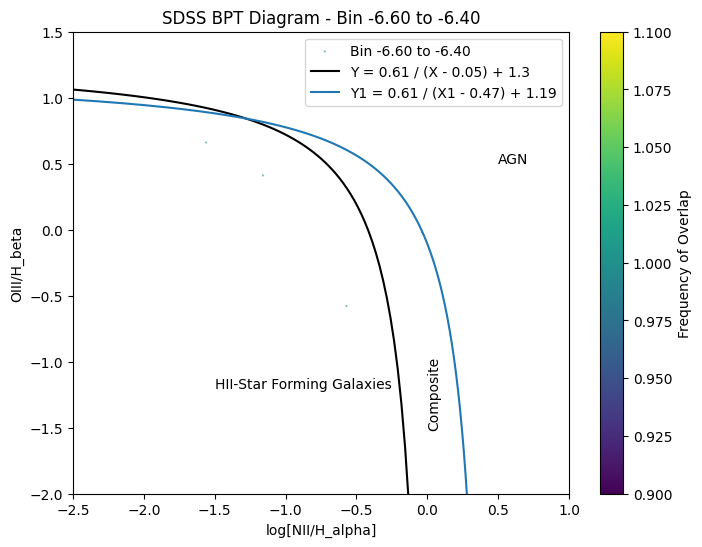

Valid data points: 3 for bin -6.40 to -6.20


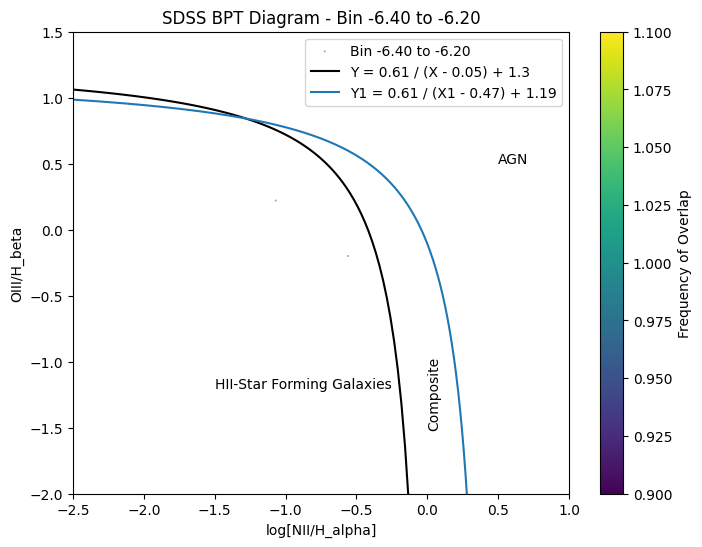

Valid data points: 8 for bin -6.20 to -6.00


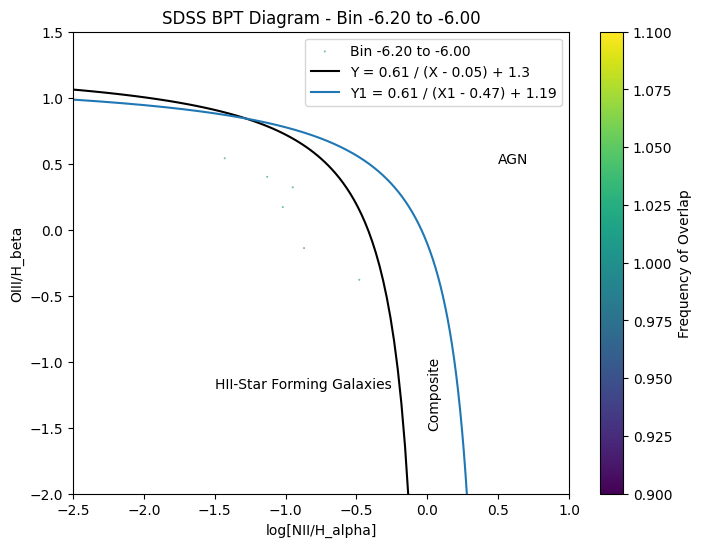

Valid data points: 6 for bin -6.00 to -5.80


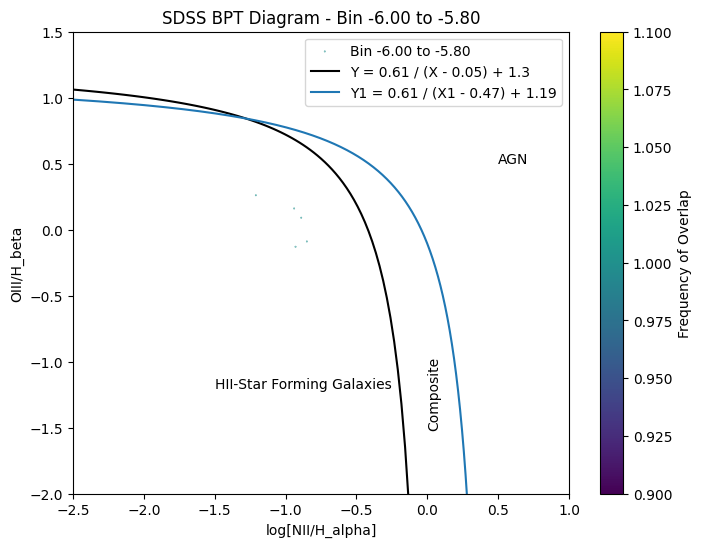

Valid data points: 5 for bin -5.80 to -5.60


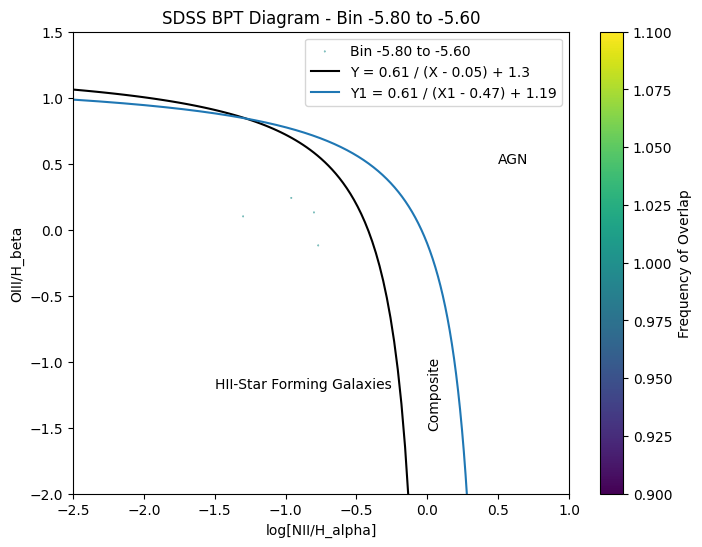

Valid data points: 2 for bin -5.60 to -5.40


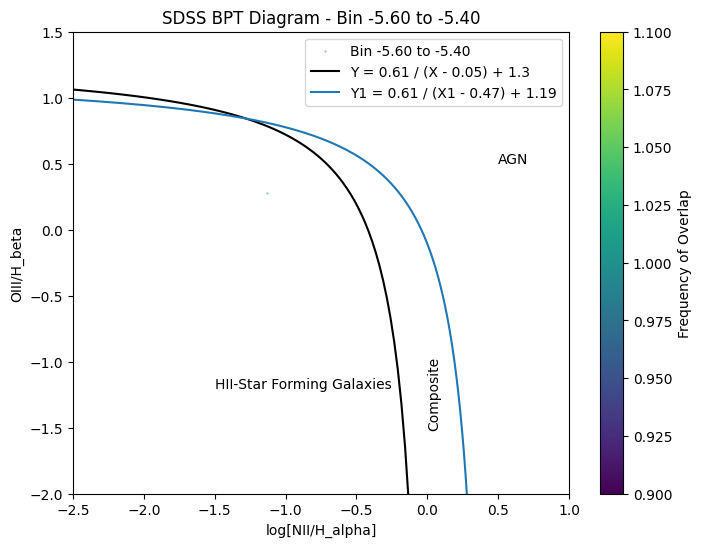

Valid data points: 1 for bin -5.40 to -5.20


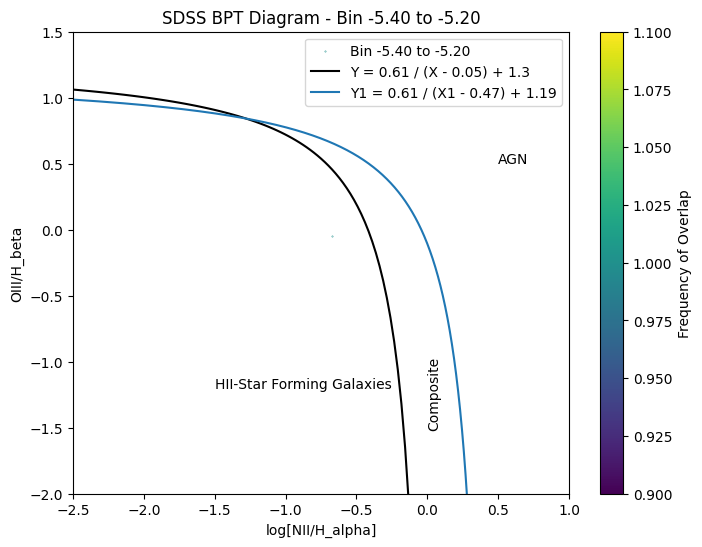

Valid data points: 3 for bin -5.20 to -5.00


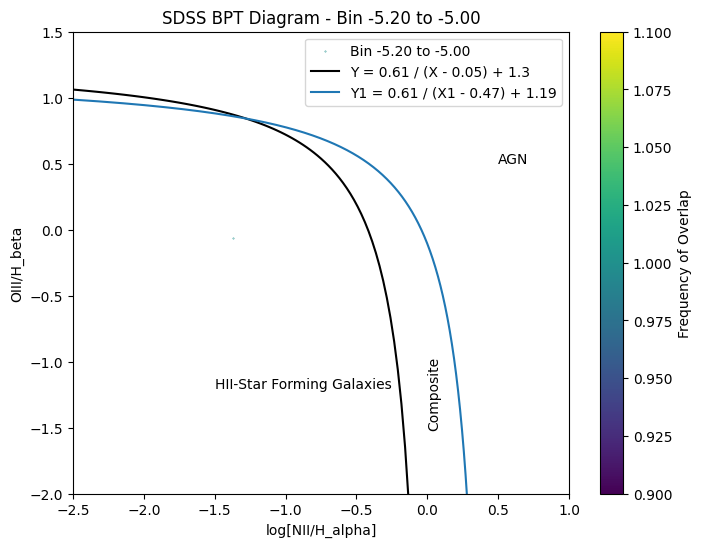

In [7]:
# Assuming you have a column 'abs_mag_bin' in your dataframe 'data'

import matplotlib.pyplot as plt
from collections import Counter

# Apply the binning
binned_data = pd.cut(galaxy_data['abs_mag_r'], bins=bins, labels=bin_labels)

# Add the binned data as a new column
galaxy_data['abs_mag_bin'] = binned_data

# Now, loop through the bins and apply your filtering logic for each bin
for bin_num in bin_labels:
    # Filter the data for the current bin
    bin_data = galaxy_data[galaxy_data['abs_mag_bin'] == bin_num]
    
    # Extract the relevant columns for the current bin
    halpha = bin_data['h_alpha_flux']
    halpha_err = bin_data['h_alpha_flux_err']
    hbeta = bin_data['h_beta_flux']
    hbeta_err = bin_data['h_beta_flux_err']
    oiii = bin_data['oiii_5007_flux']
    oiii_err = bin_data['oiii_5007_flux_err']
    nii = bin_data['nii_6584_flux']
    nii_err = bin_data['nii_6584_flux_err']
    
    # Filter out invalid data
    valid_mask = (
        (halpha > 0) & (hbeta > 0) & (oiii > 0) & (nii > 0) &
        (halpha_err > 0) & (hbeta_err > 0) & (oiii_err > 0) & (nii_err > 0)
    )
    
    print(f"Valid data points: {valid_mask.sum()} for bin {bin_num}")   #DEBUGGING

    halpha = halpha[valid_mask]
    halpha_err = halpha_err[valid_mask]
    hbeta = hbeta[valid_mask]
    hbeta_err = hbeta_err[valid_mask]
    oiii = oiii[valid_mask]
    oiii_err = oiii_err[valid_mask]
    nii = nii[valid_mask]
    nii_err = nii_err[valid_mask]

    # Apply your specific filtering criteria (flux ratio thresholds)
    ha_new = []
    hb_new = []
    oiii_new = []
    nii_new = []

    for ha, ha_err, hb, hb_err, oiii, oiii_err, nii, nii_err in zip(halpha, halpha_err, hbeta, hbeta_err, oiii, oiii_err, nii, nii_err):
        if (ha / ha_err > 3) & (hb / hb_err > 3) & (oiii / oiii_err > 3) & (nii / nii_err > 3) & (nii / hb > 0) & (oiii / ha > 0):
            ha_new.append(ha)
            hb_new.append(hb)
            oiii_new.append(oiii)
            nii_new.append(nii)

    # Now plot the results for the current bin
    Hor = np.array(nii_new) / np.array(ha_new)
    Ver = np.array(oiii_new) / np.array(hb_new)
    log_Hor = np.log10(Hor)
    log_Ver = np.log10(Ver)

    # Round data to reduce floating-point differences
    rounded_Hor = np.round(log_Hor, decimals=2)
    rounded_Ver = np.round(log_Ver, decimals=2)

    # Count occurrences of each point
    points = list(zip(rounded_Hor, rounded_Ver))
    counts = Counter(points)

    # Extract points and their counts
    unique_points = np.array(list(counts.keys()))

    # Check if unique_points is empty or not in the expected 2D shape
    if unique_points.size == 0:
        print(f"No valid points for bin {bin_num}. Skipping plot.")
        continue

    # Ensure unique_points is a 2D array
    if unique_points.ndim == 1:
        unique_points = unique_points.reshape(1, -1)  # Convert to 2D array for a single point

    # Extract x and y coordinates and densities
    x_unique = unique_points[:, 0]
    y_unique = unique_points[:, 1]
    densities = np.array(list(counts.values()))

    # Create scatter plot for the current bin
    plt.figure(figsize=(8, 6))
    scatter = plt.scatter(x_unique, y_unique, s=0.1, c=densities, cmap='viridis', label=f'Bin {bin_num}')
    plt.colorbar(scatter, label='Frequency of Overlap')

    # Plot additional curves
    X = np.linspace(-2.5, 0.049, 100)
    Y = 0.61 / (X - 0.05) + 1.3
    plt.plot(X, Y, c='k', label='Y = 0.61 / (X - 0.05) + 1.3')

    X1 = np.linspace(-2.5, 0.46, 1900)
    Y1 = 0.61 / (X1 - 0.47) + 1.19
    plt.plot(X1, Y1, label='Y1 = 0.61 / (X1 - 0.47) + 1.19')

    # Add text annotations
    plt.text(-1.5, -1.2, 'HII-Star Forming Galaxies')
    plt.text(0, -1.5, 'Composite', rotation=90)
    plt.text(0.5, 0.5, 'AGN')

    # Set plot titles and labels
    plt.title(f'SDSS BPT Diagram - Bin {bin_num}')
    plt.xlabel('log[NII/H_alpha]')
    plt.ylabel('OIII/H_beta')
    plt.legend()
    plt.xlim(-2.5, 1)
    plt.ylim(-2, 1.5)

    # Show plot for current bin
    plt.show()
    
    #don't show plot
    #plt.close()

#print(data.index)  # Check the index values

In [8]:
len(ha_new), len(halpha)

(1, 3)

In [9]:
# Assuming `data`, `bins`, and `bin_labels` are already defined
# Apply the binning
binned_data = pd.cut(galaxy_data['abs_mag_r'], bins=bins, labels=bin_labels)
galaxy_data['abs_mag_bin'] = binned_data

print(galaxy_data['abs_mag_bin'].head())  # Preview the first few entries of the data

0    -7.60 to -7.40
1    -6.00 to -5.80
2    -8.40 to -8.20
3               NaN
4    -9.20 to -9.00
Name: abs_mag_bin, dtype: category
Categories (85, object): ['-22.00 to -21.80' < '-21.80 to -21.60' < '-21.60 to -21.40' < '-21.40 to -21.20' ... '-5.80 to -5.60' < '-5.60 to -5.40' < '-5.40 to -5.20' < '-5.20 to -5.00']


# PLOT BPT Diagram

# 0.61/[log([NII]/Hα) - 0.47] + 1.19 < log([OIII]/Hβ)

# 0.61/[log([NII]/Hα) - 0.05] + 1.3 < log([OIII]/Hβ)

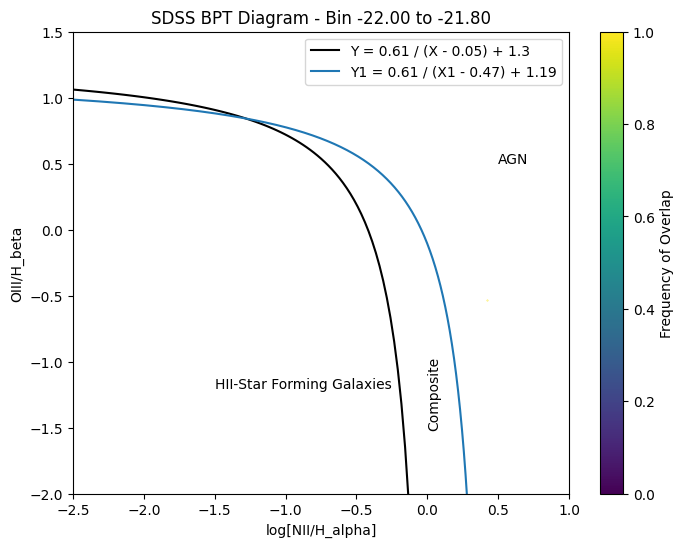

In [10]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from collections import Counter
import numpy as np
import pandas as pd

# Assuming `data`, `bins`, and `bin_labels` are already defined
# Apply the binning
binned_data = pd.cut(galaxy_data['abs_mag_r'], bins=bins, labels=bin_labels)
galaxy_data['abs_mag_bin'] = binned_data

# Create the figure and axis for the plot
fig, ax = plt.subplots(figsize=(8, 6))

# Set static plot features
ax.set_xlim(-2.5, 1)
ax.set_ylim(-2, 1.5)
ax.set_xlabel('log[NII/H_alpha]')
ax.set_ylabel('OIII/H_beta')
ax.set_title('SDSS BPT Diagram - Animation')

# Plot additional static curves
X = np.linspace(-2.5, 0.049, 100)
Y = 0.61 / (X - 0.05) + 1.3
ax.plot(X, Y, c='k', label='Y = 0.61 / (X - 0.05) + 1.3')

X1 = np.linspace(-2.5, 0.46, 1900)
Y1 = 0.61 / (X1 - 0.47) + 1.19
ax.plot(X1, Y1, label='Y1 = 0.61 / (X1 - 0.47) + 1.19')

ax.text(-1.5, -1.2, 'HII-Star Forming Galaxies')
ax.text(0, -1.5, 'Composite', rotation=90)
ax.text(0.5, 0.5, 'AGN')
ax.legend()

# Initialize an empty scatter plot
scatter = ax.scatter([], [], s=0.1, c=[], cmap='viridis')
cbar = plt.colorbar(scatter, ax=ax, label='Frequency of Overlap')

# Function to update the scatter plot for each frame (bin)
def update(frame):
    # Get bin label for the current frame
    bin_num = bin_labels[frame]
    bin_data = galaxy_data[galaxy_data['abs_mag_bin'] == bin_num]

    # Extract and filter data
    halpha = bin_data['h_alpha_flux']
    halpha_err = bin_data['h_alpha_flux_err']
    hbeta = bin_data['h_beta_flux']
    hbeta_err = bin_data['h_beta_flux_err']
    oiii = bin_data['oiii_5007_flux']
    oiii_err = bin_data['oiii_5007_flux_err']
    nii = bin_data['nii_6584_flux']
    nii_err = bin_data['nii_6584_flux_err']
    valid_mask = (
        (halpha > 0) & (hbeta > 0) & (oiii > 0) & (nii > 0) &
        (halpha_err > 0) & (hbeta_err > 0) & (oiii_err > 0) & (nii_err > 0)
    )
    halpha = halpha[valid_mask]
    hbeta = hbeta[valid_mask]
    oiii = oiii[valid_mask]
    nii = nii[valid_mask]

    ha_new = []
    hb_new = []
    oiii_new = []
    nii_new = []

    for ha, hb, oiii_flux, nii_flux in zip(halpha, hbeta, oiii, nii):
        if (nii_flux / hb > 0) & (oiii_flux / ha > 0):
            ha_new.append(ha)
            hb_new.append(hb)
            oiii_new.append(oiii_flux)
            nii_new.append(nii_flux)

    Hor = np.array(nii_new) / np.array(ha_new)
    Ver = np.array(oiii_new) / np.array(hb_new)
    log_Hor = np.log10(Hor)
    log_Ver = np.log10(Ver)

    # Count occurrences for density
    rounded_Hor = np.round(log_Hor, decimals=2)
    rounded_Ver = np.round(log_Ver, decimals=2)
    points = list(zip(rounded_Hor, rounded_Ver))
    counts = Counter(points)

    # Extract points and their counts
    unique_points = np.array(list(counts.keys()))

    # Check if unique_points is empty or not in the expected 2D shape
    if unique_points.size == 0:
        print(f"No valid points for bin {bin_num}. Skipping plot.")
        return

    # Ensure unique_points is a 2D array
    if unique_points.ndim == 1:
        unique_points = unique_points.reshape(1, -1)  # Convert to 2D array for a single point

    # Extract x and y coordinates and densities
    x_unique = unique_points[:, 0]
    y_unique = unique_points[:, 1]
    densities = np.array(list(counts.values()))

    # Update scatter plot
    scatter.set_offsets(np.c_[x_unique, y_unique])
    scatter.set_array(densities)
    scatter.set_clim(0, densities.max())  # Adjust color scale dynamically
    ax.set_title(f'SDSS BPT Diagram - Bin {bin_num}')

# Create the animation
ani = FuncAnimation(fig, update, frames=len(bin_labels), interval=500, repeat=True)

# Save the animation
ani.save('binned_bpt_animation.gif', writer='pillow')

#plt.show()

from IPython.display import HTML

# Display the animation in the notebook
HTML(ani.to_jshtml())



In [11]:
galaxy_data

,objID,modelmag_r,abs_mag_r,specObjID,petroMag_u,petroMag_g,petroMag_r,petroMag_i,petroMag_z,petroMagErr_u,...,sii_6731_eqw_err,sii_6731_flux,sii_6731_flux_err,ariii7135_eqw,ariii7135_eqw_err,ariii7135_flux,ariii7135_flux_err,specObjID1,abs_mag_bin,z_bin
0,1237657630066540695,15.671163,-7.488018,b'995427773751257088',16.834173,15.979703,15.705059,15.741057,15.810595,0.037507,...,0.424096,4.193476,1.307252,-1.007366,0.356471,3.535437,1.396682,b'995427773751257088',-7.60 to -7.40,"(0.001, 0.0476]"
1,1237661068725977297,17.256344,-5.907308,b'1987223014453831680',21.198799,17.891329,17.356182,17.344650,17.150141,1.465301,...,1.073117,6.354053,1.031324,-1.212365,0.787565,1.690381,0.985130,b'1987223014453831680',-6.00 to -5.80,"(0.001, 0.0476]"
2,1237664672713015366,14.782543,-8.392604,b'2255344422042494976',16.771311,15.149790,14.933094,15.017537,15.628313,0.164815,...,0.782532,3.714741,1.164671,-0.651219,0.561350,0.920791,1.075721,b'2255344422042494976',-8.40 to -8.20,"(0.001, 0.0476]"
3,1237667322183811232,20.136375,-3.057084,b'2514169191104276480',20.934614,20.384708,20.276474,20.301836,20.666374,0.222107,...,0.422019,23.493216,1.507279,-0.999026,0.358037,5.503108,1.364016,b'2514169191104276480',NaN,"(0.001, 0.0476]"
4,1237661387067424781,14.211454,-9.051882,b'1490741831124674560',15.770568,14.384749,14.246041,14.615235,14.998849,0.045249,...,0.478080,117.926849,2.100613,-26.655220,0.485438,132.529053,2.293786,b'1490741831124674560',-9.20 to -9.00,"(0.001, 0.0476]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
792387,1237661971725353329,19.613684,-17.761058,b'2015510981614004224',22.299257,21.043064,19.521130,18.563250,17.958851,0.857801,...,-1.000000,0.000000,-0.791747,0.000000,-1.000000,0.000000,-0.791747,b'2015510981614004224',-17.80 to -17.60,"(0.653, 0.7]"
792388,1237667254018441560,20.042629,-17.333987,b'2783267520713353216',21.623619,20.570557,20.062828,19.854187,20.177282,0.190512,...,-1.000000,0.000000,-0.804947,0.000000,-1.000000,0.000000,-0.804947,b'2783267520713353216',-17.40 to -17.20,"(0.653, 0.7]"
792389,1237661950255301313,21.105656,-16.273359,b'1818445225777981440',25.933968,22.029610,21.211866,20.064531,19.850765,1.361330,...,-1.000000,0.000000,-0.775383,0.000000,-1.000000,0.000000,-0.775383,b'1818445225777981440',-16.40 to -16.20,"(0.653, 0.7]"
792390,1237663237128258189,20.673914,-16.705132,b'800528064848095232',22.296127,21.791883,20.714472,19.983740,19.433069,0.426404,...,-1.000000,0.000000,-0.828007,0.000000,-1.000000,0.000000,-0.828007,b'800528064848095232',-16.80 to -16.60,"(0.653, 0.7]"


In [12]:
#Step 2: Define bins for the z column

# Define the bin edges for `z` (you can adjust these ranges)
z_bins = np.linspace(galaxy_data['z'].min(), galaxy_data['z'].max(), num=20)  # Create bins from MAX to MIN with 20 bins
z_bins

array([0.0010009 , 0.03775437, 0.07450783, 0.1112613 , 0.14801477,
       0.18476823, 0.2215217 , 0.25827515, 0.29502863, 0.3317821 ,
       0.36853555, 0.40528902, 0.4420425 , 0.47879595, 0.51554936,
       0.55230284, 0.5890563 , 0.6258098 , 0.66256326, 0.6993167 ],
      dtype=float32)

In [13]:
# Ensure bins are in increasing order
z_bins = np.sort(z_bins)
print(z_bins)

# Check the types of the original magnitude data to ensure they're numeric
print(galaxy_data['z'].dtype)

# Generate labels (one fewer than bin edges)
z_bin_labels = [f'{z_bins[i]:.3f} to {z_bins[i+1]:.3f}' for i in range(len(z_bins) - 1)]
print(z_bin_labels)

# Apply the binning
z_binned_data = pd.cut(galaxy_data['z'], bins=z_bins, labels=z_bin_labels)

# Add the binned data as a new column
galaxy_data['z_bin'] = binned_data

# Now check the first few rows of the data to confirm the 'abs_mag_bin' column was added
print(galaxy_data.head())  # Preview the first few entries of the data


[0.0010009  0.03775437 0.07450783 0.1112613  0.14801477 0.18476823
 0.2215217  0.25827515 0.29502863 0.3317821  0.36853555 0.40528902
 0.4420425  0.47879595 0.51554936 0.55230284 0.5890563  0.6258098
 0.66256326 0.6993167 ]
float32
['0.001 to 0.038', '0.038 to 0.075', '0.075 to 0.111', '0.111 to 0.148', '0.148 to 0.185', '0.185 to 0.222', '0.222 to 0.258', '0.258 to 0.295', '0.295 to 0.332', '0.332 to 0.369', '0.369 to 0.405', '0.405 to 0.442', '0.442 to 0.479', '0.479 to 0.516', '0.516 to 0.552', '0.552 to 0.589', '0.589 to 0.626', '0.626 to 0.663', '0.663 to 0.699']
                 objID  modelmag_r  abs_mag_r               specObjID  \
0  1237657630066540695   15.671163  -7.488018   b'995427773751257088'   
1  1237661068725977297   17.256344  -5.907308  b'1987223014453831680'   
2  1237664672713015366   14.782543  -8.392604  b'2255344422042494976'   
3  1237667322183811232   20.136375  -3.057084  b'2514169191104276480'   
4  1237661387067424781   14.211454  -9.051882  b'14907418311

In [14]:
import numpy as np
import pandas as pd

# Define bin edges
z_bins = np.linspace(galaxy_data['z'].min(), galaxy_data['z'].max(), num=50)  # Adjust bin count if needed
z_bins = np.sort(z_bins)  # Ensure bins are increasing

# Generate labels (one fewer than number of bin edges)
z_bin_labels = [f'{z_bins[i]:.2f} to {z_bins[i+1]:.2f}' for i in range(len(z_bins) - 1)]

# Apply binning with correct labels
galaxy_data['z_bin'] = pd.cut(galaxy_data['z'], bins=z_bins, labels=z_bin_labels, include_lowest=True)

# Check for NaN values in the new binned column
nan_entries = galaxy_data[galaxy_data['z_bin'].isna()]
print(f"Entries with NaN in 'z_bin': {len(nan_entries)}")

# Group by bins
z_grouped = galaxy_data.groupby('z_bin').size()

# Print final bin counts
print(z_grouped)


Entries with NaN in 'z_bin': 0
z_bin
0.00 to 0.02     6344
0.02 to 0.03    26861
0.03 to 0.04    42463
0.04 to 0.06    50867
0.06 to 0.07    67629
0.07 to 0.09    83935
0.09 to 0.10    65865
0.10 to 0.12    66403
0.12 to 0.13    63441
0.13 to 0.14    58834
0.14 to 0.16    45530
0.16 to 0.17    35552
0.17 to 0.19    29381
0.19 to 0.20    22066
0.20 to 0.21    15677
0.21 to 0.23    12062
0.23 to 0.24     8797
0.24 to 0.26     7188
0.26 to 0.27     6473
0.27 to 0.29     6235
0.29 to 0.30     6592
0.30 to 0.31     6696
0.31 to 0.33     7716
0.33 to 0.34     8409
0.34 to 0.36     7629
0.36 to 0.37     6845
0.37 to 0.39     5723
0.39 to 0.40     4656
0.40 to 0.41     3893
0.41 to 0.43     3206
0.43 to 0.44     2453
0.44 to 0.46     2157
0.46 to 0.47     1557
0.47 to 0.49     1118
0.49 to 0.50      688
0.50 to 0.51      423
0.51 to 0.53      253
0.53 to 0.54      179
0.54 to 0.56      147
0.56 to 0.57       89
0.57 to 0.59       68
0.59 to 0.60       67
0.60 to 0.61       33
0.61 to 0.63     

C:\Users\chloe\AppData\Local\Temp\ipykernel_18424\612744403.py:19: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  z_grouped = galaxy_data.groupby('z_bin').size()


z_bin
0.07 to 0.09    83935
0.06 to 0.07    67629
0.10 to 0.12    66403
0.09 to 0.10    65865
0.12 to 0.13    63441
0.13 to 0.14    58834
0.04 to 0.06    50867
0.14 to 0.16    45530
0.03 to 0.04    42463
0.16 to 0.17    35552
0.17 to 0.19    29381
0.02 to 0.03    26861
0.19 to 0.20    22066
0.20 to 0.21    15677
0.21 to 0.23    12062
0.23 to 0.24     8797
0.33 to 0.34     8409
0.31 to 0.33     7716
0.34 to 0.36     7629
0.24 to 0.26     7188
0.36 to 0.37     6845
0.30 to 0.31     6696
0.29 to 0.30     6592
0.26 to 0.27     6473
0.00 to 0.02     6343
0.27 to 0.29     6235
0.37 to 0.39     5723
0.39 to 0.40     4656
0.40 to 0.41     3893
0.41 to 0.43     3206
0.43 to 0.44     2453
0.44 to 0.46     2157
0.46 to 0.47     1557
0.47 to 0.49     1118
0.49 to 0.50      688
0.50 to 0.51      423
0.51 to 0.53      253
0.53 to 0.54      179
0.54 to 0.56      147
0.56 to 0.57       89
0.57 to 0.59       68
0.59 to 0.60       67
0.61 to 0.63       47
0.69 to 0.70       40
0.63 to 0.64       38
0.60

z_bin
0.07 to 0.09    83935
0.06 to 0.07    67629
0.10 to 0.12    66403
0.09 to 0.10    65865
0.12 to 0.13    63441
0.13 to 0.14    58834
0.04 to 0.06    50867
0.14 to 0.16    45530
0.03 to 0.04    42463
0.16 to 0.17    35552
0.17 to 0.19    29381
0.02 to 0.03    26861
0.19 to 0.20    22066
0.20 to 0.21    15677
0.21 to 0.23    12062
0.23 to 0.24     8797
0.33 to 0.34     8409
0.31 to 0.33     7716
0.34 to 0.36     7629
0.24 to 0.26     7188
0.36 to 0.37     6845
0.30 to 0.31     6696
0.29 to 0.30     6592
0.26 to 0.27     6473
0.00 to 0.02     6343
0.27 to 0.29     6235
0.37 to 0.39     5723
0.39 to 0.40     4656
0.40 to 0.41     3893
0.41 to 0.43     3206
0.43 to 0.44     2453
0.44 to 0.46     2157
0.46 to 0.47     1557
0.47 to 0.49     1118
0.49 to 0.50      688
0.50 to 0.51      423
0.51 to 0.53      253
0.53 to 0.54      179
0.54 to 0.56      147
0.56 to 0.57       89
0.57 to 0.59       68
0.59 to 0.60       67
0.61 to 0.63       47
0.69 to 0.70       40
0.63 to 0.64       38
0.60

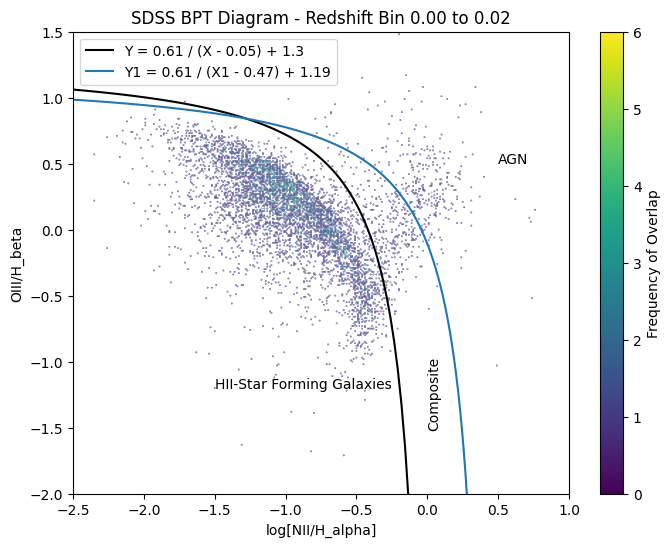

In [15]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from collections import Counter
import numpy as np
import pandas as pd

# Assuming `data`, `bins`, and `bin_labels` are already defined
# Apply the binning
z_binned_data = pd.cut(galaxy_data['z'], bins=z_bins, labels=z_bin_labels)
galaxy_data['z_bin'] = z_binned_data

galaxy_data['z_bin']
print(galaxy_data['z_bin'].value_counts())

# Create the figure and axis for the plot
fig, ax = plt.subplots(figsize=(8, 6))

# Set static plot features
ax.set_xlim(-2.5, 1)
ax.set_ylim(-2, 1.5)
ax.set_xlabel('log[NII/H_alpha]')
ax.set_ylabel('OIII/H_beta')
ax.set_title('SDSS BPT Diagram - Animation through z')

# Plot additional static curves
X = np.linspace(-2.5, 0.049, 100)
Y = 0.61 / (X - 0.05) + 1.3
ax.plot(X, Y, c='k', label='Y = 0.61 / (X - 0.05) + 1.3')

X1 = np.linspace(-2.5, 0.46, 1900)
Y1 = 0.61 / (X1 - 0.47) + 1.19
ax.plot(X1, Y1, label='Y1 = 0.61 / (X1 - 0.47) + 1.19')

ax.text(-1.5, -1.2, 'HII-Star Forming Galaxies')
ax.text(0, -1.5, 'Composite', rotation=90)
ax.text(0.5, 0.5, 'AGN')
ax.legend()

# Initialize an empty scatter plot
scatter = ax.scatter([], [], s=0.1, c=[], cmap='viridis')
cbar = plt.colorbar(scatter, ax=ax, label='Frequency of Overlap')

# Function to update the scatter plot for each frame (bin)
def update(frame):
    # Get bin label for the current frame
    bin_num = z_bin_labels[frame]
    bin_data = galaxy_data[galaxy_data['z_bin'] == bin_num]

    print(galaxy_data['z_bin'].value_counts())


    # Extract and filter data
    halpha = bin_data['h_alpha_flux']
    halpha_err = bin_data['h_alpha_flux_err']
    hbeta = bin_data['h_beta_flux']
    hbeta_err = bin_data['h_beta_flux_err']
    oiii = bin_data['oiii_5007_flux']
    oiii_err = bin_data['oiii_5007_flux_err']
    nii = bin_data['nii_6584_flux']
    nii_err = bin_data['nii_6584_flux_err']
    valid_mask = (
        (halpha > 0) & (hbeta > 0) & (oiii > 0) & (nii > 0) &
        (halpha_err > 0) & (hbeta_err > 0) & (oiii_err > 0) & (nii_err > 0)
    )
    halpha = halpha[valid_mask]
    hbeta = hbeta[valid_mask]
    oiii = oiii[valid_mask]
    nii = nii[valid_mask]

    ha_new = []
    hb_new = []
    oiii_new = []
    nii_new = []

    for ha, hb, oiii_flux, nii_flux in zip(halpha, hbeta, oiii, nii):
        if (nii_flux / hb > 0) & (oiii_flux / ha > 0):
            ha_new.append(ha)
            hb_new.append(hb)
            oiii_new.append(oiii_flux)
            nii_new.append(nii_flux)

    Hor = np.array(nii_new) / np.array(ha_new)
    Ver = np.array(oiii_new) / np.array(hb_new)
    log_Hor = np.log10(Hor)
    log_Ver = np.log10(Ver)

    # Count occurrences for density
    rounded_Hor = np.round(log_Hor, decimals=2)
    rounded_Ver = np.round(log_Ver, decimals=2)
    points = list(zip(rounded_Hor, rounded_Ver))
    counts = Counter(points)

    # Extract points and their counts
    unique_points = np.array(list(counts.keys()))

    # Check if unique_points is empty or not in the expected 2D shape
    if unique_points.size == 0:
        print(f"No valid points for bin {bin_num}. Skipping plot.")
        return

    print(f"Valid points found for bin {bin_num}.")

    # Ensure unique_points is a 2D array
    if unique_points.ndim == 1:
        unique_points = unique_points.reshape(1, -1)  # Convert to 2D array for a single point

    # Extract x and y coordinates and densities
    x_unique = unique_points[:, 0]
    y_unique = unique_points[:, 1]
    densities = np.array(list(counts.values()))

    # Update scatter plot
    scatter.set_offsets(np.c_[x_unique, y_unique])
    scatter.set_array(densities)
    scatter.set_clim(0, densities.max())  # Adjust color scale dynamically
    ax.set_title(f'SDSS BPT Diagram - Redshift Bin {bin_num}')

# Create the animation
ani = FuncAnimation(fig, update, frames=len(z_bin_labels), interval=500, repeat=True)

# Save the animation
ani.save('z_binned_bpt_animation.gif', writer='pillow')

#plt.show()

from IPython.display import HTML

# Display the animation in the notebook
HTML(ani.to_jshtml())



In [16]:
#PLOT EMISSION LINES FROM ABS_MAG -17 TO -16.8

# Aggregate data: group by z and calculate percentage of galaxies with emission lines

# bin redshift values like we did with abs_mag before

#redshift_bin = np.linspace(galaxy_data['abs_mag_r'].min(), galaxy_data['abs_mag_r'].max(), num=50)  # Create bins from MAX to MIN with 20 bins
redshift_bin = np.linspace(0.001, 0.7, num=15)  # Create bins from MAX to MIN with 20 bins
galaxy_data['z_bin'] = pd.cut(galaxy_data['z'], bins=redshift_bin) # assigns each galaxy a z_bin range

redshift_bin


array([0.001     , 0.05092857, 0.10085714, 0.15078571, 0.20071429,
       0.25064286, 0.30057143, 0.3505    , 0.40042857, 0.45035714,
       0.50028571, 0.55021429, 0.60014286, 0.65007143, 0.7       ])

In [17]:
# Dynamically identify emission line columns starting from the 19th column
emission_line_columns = galaxy_data.columns[18::4][:-1]  # Select every third column starting from the 19th, except for the very last column

emission_line_columns


Index(['h_alpha_eqw', 'h_beta_eqw', 'h_gamma_eqw', 'h_delta_eqw',
       'hei_5876_eqw', 'oiii_5007_eqw', 'oiii_4959_eqw', 'oiii_4363_eqw',
       'oii_3726_eqw', 'oii_3729_eqw', 'oi_6300_eqw', 'neiii_3869_eqw',
       'nii_6584_eqw', 'nii_6548_eqw', 'sii_6717_eqw', 'sii_6731_eqw',
       'ariii7135_eqw'],
      dtype='object')

In [18]:
#calculate percentage of galaxies with emission lines for each bin and variable

# Prepare to store results for plotting
results = []

for column in emission_line_columns:
    print(f"Emission Line: {column}")

    # Calculate percentage of galaxies with the emission line in each redshift bin
    percentages = []
    
    # Iterate through each group (bin) and check if it's non-empty
    for bin_name, group in galaxy_data.groupby('z_bin'):
        print(f"  Redshift Bin: {bin_name}")
        if len(group) > 0:  # Check if the group is not empty
            # Filter galaxies with emission (where column value > 0)
            #galaxies_with_emission = group[group[column] > 0]

            # Apply the lambda to calculate the percentage
            percentage = (group[column] > 0).sum() / len(group) * 100
            percentages.append((bin_name, percentage))
            print(f"  Redshift Bin: {bin_name}, Percentage: {percentage:.2f}%")
        else:
            # If the group is empty, store a message or a NaN value for that bin
            percentages.append((bin_name, None))  # Or use np.nan if preferred
            print(f"  Redshift Bin: {bin_name}, Percentage: N/A (No galaxies in this bin)")

    # Store the emission line name and its percentages
    results.append((column, dict(percentages)))
    print()  # Blank line for readability

Emission Line: h_alpha_eqw
  Redshift Bin: (0.001, 0.0509]
  Redshift Bin: (0.001, 0.0509], Percentage: 1.62%
  Redshift Bin: (0.0509, 0.101]
  Redshift Bin: (0.0509, 0.101], Percentage: 1.57%
  Redshift Bin: (0.101, 0.151]
  Redshift Bin: (0.101, 0.151], Percentage: 2.32%
  Redshift Bin: (0.151, 0.201]
  Redshift Bin: (0.151, 0.201], Percentage: 4.60%
  Redshift Bin: (0.201, 0.251]
  Redshift Bin: (0.201, 0.251], Percentage: 8.39%
  Redshift Bin: (0.251, 0.301]
  Redshift Bin: (0.251, 0.301], Percentage: 14.91%
  Redshift Bin: (0.301, 0.35]
  Redshift Bin: (0.301, 0.35], Percentage: 22.82%
  Redshift Bin: (0.35, 0.4]
  Redshift Bin: (0.35, 0.4], Percentage: 29.18%
  Redshift Bin: (0.4, 0.45]
  Redshift Bin: (0.4, 0.45], Percentage: 0.59%
  Redshift Bin: (0.45, 0.5]
  Redshift Bin: (0.45, 0.5], Percentage: 0.00%
  Redshift Bin: (0.5, 0.55]
  Redshift Bin: (0.5, 0.55], Percentage: 0.00%
  Redshift Bin: (0.55, 0.6]
  Redshift Bin: (0.55, 0.6], Percentage: 0.00%
  Redshift Bin: (0.6, 0.65

C:\Users\chloe\AppData\Local\Temp\ipykernel_18424\3569448671.py:13: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for bin_name, group in galaxy_data.groupby('z_bin'):


  Redshift Bin: (0.001, 0.0509]
  Redshift Bin: (0.001, 0.0509], Percentage: 6.59%
  Redshift Bin: (0.0509, 0.101]
  Redshift Bin: (0.0509, 0.101], Percentage: 8.97%
  Redshift Bin: (0.101, 0.151]
  Redshift Bin: (0.101, 0.151], Percentage: 12.52%
  Redshift Bin: (0.151, 0.201]
  Redshift Bin: (0.151, 0.201], Percentage: 15.40%
  Redshift Bin: (0.201, 0.251]
  Redshift Bin: (0.201, 0.251], Percentage: 19.66%
  Redshift Bin: (0.251, 0.301]
  Redshift Bin: (0.251, 0.301], Percentage: 19.57%
  Redshift Bin: (0.301, 0.35]
  Redshift Bin: (0.301, 0.35], Percentage: 24.06%
  Redshift Bin: (0.35, 0.4]
  Redshift Bin: (0.35, 0.4], Percentage: 27.26%
  Redshift Bin: (0.4, 0.45]
  Redshift Bin: (0.4, 0.45], Percentage: 30.85%
  Redshift Bin: (0.45, 0.5]
  Redshift Bin: (0.45, 0.5], Percentage: 32.69%
  Redshift Bin: (0.5, 0.55]
  Redshift Bin: (0.5, 0.55], Percentage: 29.20%
  Redshift Bin: (0.55, 0.6]
  Redshift Bin: (0.55, 0.6], Percentage: 17.61%
  Redshift Bin: (0.6, 0.65]
  Redshift Bin: (0

In [19]:
# #code to adjust z bins

# import numpy as np
# import pandas as pd

# # Define bin edges for z based on the given range (0.001 to 0.7)
# z_bins = np.linspace(0.001, 0.7, 11)  # Creates 10 bins

# # Create a new 'z_bin' column based on these bins
# galaxy_data['z_bin'] = pd.cut(galaxy_data['z'], bins=z_bins, right=False)

# # Check the first few rows of the updated DataFrame
# print(galaxy_data[['z', 'z_bin']].head())

C:\Users\chloe\AppData\Local\Temp\ipykernel_18424\2476592850.py:17: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for bin_name, group in galaxy_data.groupby('z_bin'):


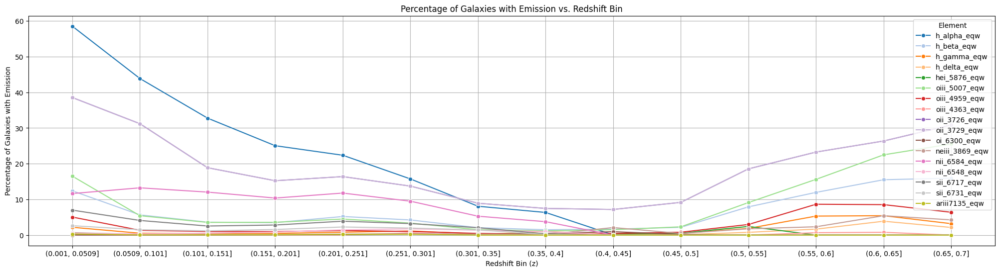

Redshift (z) range: (np.float32(0.0010009038), np.float32(0.6993167))


Index(['h_alpha_eqw', 'h_beta_eqw', 'h_gamma_eqw', 'h_delta_eqw',
       'hei_5876_eqw', 'oiii_5007_eqw', 'oiii_4959_eqw', 'oiii_4363_eqw',
       'oii_3726_eqw', 'oii_3729_eqw', 'oi_6300_eqw', 'neiii_3869_eqw',
       'nii_6584_eqw', 'nii_6548_eqw', 'sii_6717_eqw', 'sii_6731_eqw',
       'ariii7135_eqw'],
      dtype='object')

In [20]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Assuming 'galaxy_data' is your dataframe and 'emission_line_columns' is the list of columns with equivalent width values
# and 'data' contains a 'z_bin' column for redshift bins.



# Prepare to store results for plotting
results = []

for column in emission_line_columns:
    percentages = []
    
    # Iterate through each redshift bin and calculate the percentage of galaxies with the emission line (EW < -10)
    for bin_name, group in galaxy_data.groupby('z_bin'):
        if len(group) > 0:  # Ensure the group isn't empty
            # Calculate the percentage of galaxies with the emission line in the current bin
            percentage = (group[column] < -10).sum() / len(group) * 100
            # Convert bin_name (interval) to a string for better display
            bin_name_str = str(bin_name)
            percentages.append((bin_name_str, percentage))
        else:
            # Handle empty bins
            percentages.append((None, None))  # Use None for empty bins

    # Store the emission line name and its corresponding percentage data
    results.append((column, dict(percentages)))

# Convert the results to a pandas DataFrame for easy plotting
plot_data = []

for emission_line, percentages in results:
    for bin_name, percentage in percentages.items():
        plot_data.append({'z_bin': bin_name, 'element': emission_line, 'percentage': percentage})

plot_df = pd.DataFrame(plot_data)

# Create a custom color palette for the emission lines
custom_palette = sns.color_palette("tab20", n_colors=17)

# Create the connected scatter plot
plt.figure(figsize=(25, 6))

sns.lineplot(data=plot_df, x='z_bin', y='percentage', hue='element', palette=custom_palette, marker='o')

# Customize plot with titles and labels
plt.title('Percentage of Galaxies with Emission vs. Redshift Bin')
plt.xlabel('Redshift Bin (z)')
plt.ylabel('Percentage of Galaxies with Emission')
plt.legend(title='Element', loc='upper right')  # Adjust legend position if needed
plt.grid(True)  # Optional: Add gridlines for better readability

# Display the plot
plt.show()
plot_df
galaxy_data['z_bin']
# Check the range of 'z' values in your data
z_range = galaxy_data['z'].min(), galaxy_data['z'].max()
print(f"Redshift (z) range: {z_range}")

emission_line_columns


In [21]:
galaxy_data['abs_mag_bin']

0           -7.60 to -7.40
1           -6.00 to -5.80
2           -8.40 to -8.20
3                      NaN
4           -9.20 to -9.00
                ...       
792387    -17.80 to -17.60
792388    -17.40 to -17.20
792389    -16.40 to -16.20
792390    -16.80 to -16.60
792391    -18.00 to -17.80
Name: abs_mag_bin, Length: 792392, dtype: category
Categories (85, object): ['-22.00 to -21.80' < '-21.80 to -21.60' < '-21.60 to -21.40' < '-21.40 to -21.20' ... '-5.80 to -5.60' < '-5.60 to -5.40' < '-5.40 to -5.20' < '-5.20 to -5.00']

In [22]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Assuming 'galaxy_data' is your DataFrame and 'emission_line_columns' contains the emission line column names.

# Prepare to store results for plotting
results = []

for column in emission_line_columns:
    percentages = []
    
    # Iterate through each abs_mag bin
    for abs_mag_bin, abs_group in galaxy_data.groupby('abs_mag_bin'):
        if abs_group.empty:
            continue  # Skip empty bins
        
        # Iterate through each redshift bin and calculate the percentage
        for z_bin, group in abs_group.groupby('z_bin'):
            if len(group) > 0:  # Ensure the group isn't empty
                percentage = (group[column] < -10).sum() / len(group) * 100
                percentages.append({'abs_mag_bin': abs_mag_bin, 'z_bin': str(z_bin), 'element': column, 'percentage': percentage})

    # Add results for the current emission line
    results.extend(percentages)

# Convert the results to a DataFrame
plot_df = pd.DataFrame(results)

# Ensure 'z_bin' is a categorical type for better plotting
plot_df['z_bin'] = pd.Categorical(plot_df['z_bin'], ordered=True)

# Set up the custom color palette
custom_palette = sns.color_palette("tab20", n_colors=len(emission_line_columns))

# Get unique abs_mag bins for plotting
unique_abs_mag_bins = plot_df['abs_mag_bin'].unique()
n_bins = len(unique_abs_mag_bins)

# Create subplots
fig, axes = plt.subplots(n_bins, 1, figsize=(25, 6 * n_bins), sharex=True, sharey=True)

# If there is only one abs_mag_bin, ensure axes is iterable
if n_bins == 1:
    axes = [axes]

for ax, abs_mag_bin in zip(axes, unique_abs_mag_bins):
    # Filter data for the current abs_mag bin
    bin_data = plot_df[plot_df['abs_mag_bin'] == abs_mag_bin]
    
    # Plot the data
    sns.lineplot(data=bin_data, x='z_bin', y='percentage', hue='element', palette=custom_palette, marker='o', ax=ax)
    
    # Customize the plot
    ax.set_title(f'Percentage of Galaxies with Emission (EW < -10) by Redshift Bin\nAbs Mag Bin: {abs_mag_bin}')
    ax.set_xlabel('Redshift Bin (z)')
    ax.set_ylabel('Percentage (%)')
    ax.grid(True)
    ax.legend(title='Emission Line', loc='upper right')

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


C:\Users\chloe\AppData\Local\Temp\ipykernel_18424\1478190291.py:14: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for abs_mag_bin, abs_group in galaxy_data.groupby('abs_mag_bin'):
C:\Users\chloe\AppData\Local\Temp\ipykernel_18424\1478190291.py:19: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for z_bin, group in abs_group.groupby('z_bin'):
